In [1]:
import numpy as np
import tensorflow as tf
import keras
import cv2
from keras.models import Sequential, load_model
from keras import layers
# from keras.preprocessing.image import img_to_array
from tensorflow.keras.utils import img_to_array
from keras.callbacks import EarlyStopping
import os
from tqdm import tqdm
import re
import matplotlib.pyplot as plt

import pandas as pd
import seaborn as sns

In [2]:
if tf.test.is_built_with_cuda():
    print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
    from tensorflow.python.client import device_lib
    print(device_lib.list_local_devices())
else: 
    print("CUDA not available")

Num GPUs Available:  1
[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 12835527975664224797
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 4139778048
locality {
  bus_id: 1
  links {
  }
}
incarnation: 11263832034977884725
physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 2060, pci bus id: 0000:01:00.0, compute capability: 7.5"
xla_global_id: 416903419
]


In [3]:
# сортировка изображений в алфавитном поряддке
def sorted_alphanumeric(data):  
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)

# общий размер для всех изображений
SIZE = 256
high_img = []
# путь к изображениям с высоким разрешением
path = '../../data/image-super-resolution/dataset/Raw Data/high_res'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):    
    if i == '855.jpg':
        break
    else:    
        img = cv2.imread(path + '/'+i,1)
        # opencv по умолчанию считывает в BGR формате, сразу конвертируем в RGB
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        # делаем одинаковый размер
        img = cv2.resize(img, (SIZE, SIZE))
        # нормализуем значения пикселей         
        img = img.astype('float32') / 255.0
        high_img.append(img_to_array(img))

low_img = []
# путь к изображениям с низким разрешением и далее все аналогично
path = '../../data/image-super-resolution/dataset/Raw Data/low_res'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):
     if i == '855.jpg':
        break
     else: 
        img = cv2.imread(path + '/'+i,1)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (SIZE, SIZE))
        img = img.astype('float32') / 255.0
        low_img.append(img_to_array(img))

100%|███████████████████████████████████████████████████████████████████████████████| 855/855 [00:02<00:00, 381.22it/s]


High:  855 
 Low:  855


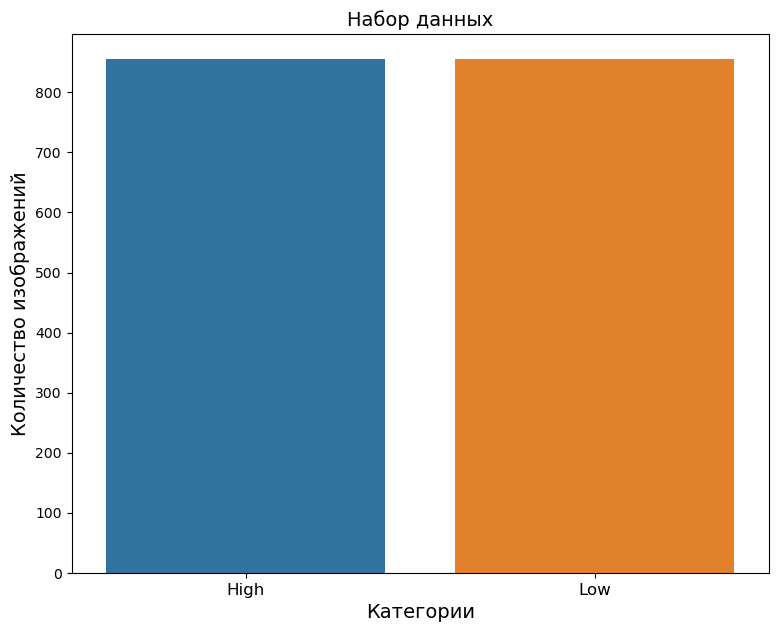

In [4]:
train_data = []

# передаем изображения в список train_data, устанавливаем метки 0 для здоровых и 1 для больных
for img in high_img:
    train_data.append((img,0))

for img in low_img:
    train_data.append((img, 1))
    
# создаем pandas dataframe - двумерный массив из изображений и меток для дальнейшей работы
train_data = pd.DataFrame(train_data, columns=['image', 'label'],index=None)

cases_count = train_data['label'].value_counts()
print('High: ', cases_count[0],'\n', 'Low: ', cases_count[1])
# визуализируем 
plt.figure(figsize=(9,7))
sns.barplot(x=cases_count.index, y= cases_count.values)
plt.title('Набор данных', fontsize=14)
plt.xlabel('Категории', fontsize=14)
plt.ylabel('Количество изображений', fontsize=14)
plt.xticks(range(len(cases_count.index)), ['High', 'Low'], fontsize=12)
plt.show()

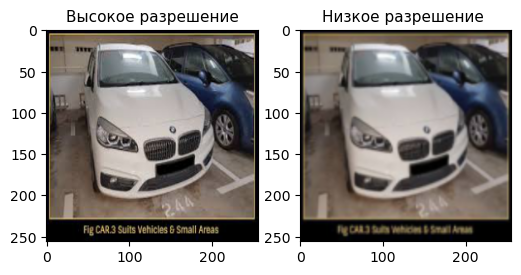

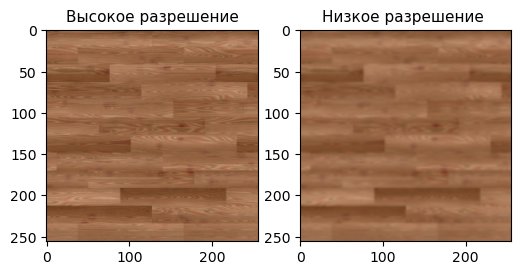

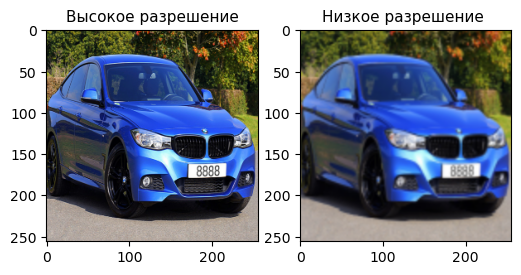

In [13]:
for i in range(3):
    # берем случайное изображение     
    a = np.random.randint(0,855)
    # определяем размер каждой фигуры
    plt.figure(figsize=(6,6))
    # положение фигуры
    plt.subplot(1,2,1)
    # заголовок фигуры
    plt.title('Высокое разрешение', fontsize = 11)
    # вывод на экран
    plt.imshow(high_img[a])
    plt.subplot(1,2,2)
    plt.title('Низкое разрешение ', fontsize = 11)
    plt.imshow(low_img[a])

In [5]:
train_high_image = high_img[:700]
train_low_image = low_img[:700]
train_high_image = np.reshape(train_high_image,(len(train_high_image),SIZE,SIZE,3))
train_low_image = np.reshape(train_low_image,(len(train_low_image),SIZE,SIZE,3))

validation_high_image = high_img[700:830]
validation_low_image = low_img[700:830]
validation_high_image= np.reshape(validation_high_image,(len(validation_high_image),SIZE,SIZE,3))
validation_low_image = np.reshape(validation_low_image,(len(validation_low_image),SIZE,SIZE,3))

test_high_image = high_img[830:]
test_low_image = low_img[830:]
test_high_image= np.reshape(test_high_image,(len(test_high_image),SIZE,SIZE,3))
test_low_image = np.reshape(test_low_image,(len(test_low_image),SIZE,SIZE,3))

print("Shape of training images:",train_high_image.shape)
print("Shape of test images:",test_high_image.shape)
print("Shape of validation images:",validation_high_image.shape)

Shape of training images: (700, 256, 256, 3)
Shape of test images: (25, 256, 256, 3)
Shape of validation images: (130, 256, 256, 3)


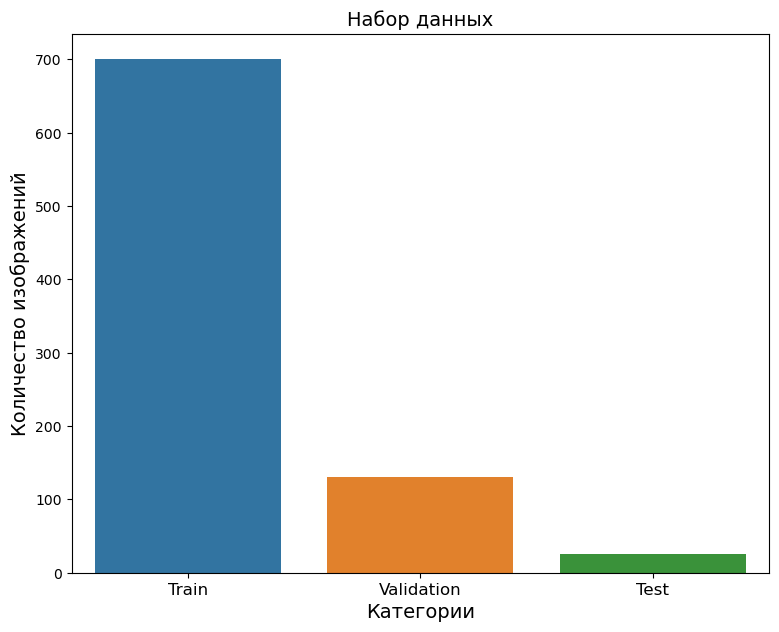

In [6]:
plt.figure(figsize=(9,7))
sns.barplot(x=[0, 1, 2], y=[train_high_image.shape[0], validation_high_image.shape[0], test_high_image.shape[0]])
plt.title('Набор данных', fontsize=14)
plt.xlabel('Категории', fontsize=14)
plt.ylabel('Количество изображений', fontsize=14)
plt.xticks(range(3), ['Train', 'Validation', 'Test'], fontsize=12)
plt.show()

In [6]:
def down(filters, kernel_size, apply_batch_normalization = True):
    downsample = tf.keras.models.Sequential()
    downsample.add(layers.Conv2D(filters,kernel_size,padding = 'same', strides = 2))
    if apply_batch_normalization:
        downsample.add(layers.BatchNormalization())
    downsample.add(keras.layers.LeakyReLU())
    return downsample

def up(filters, kernel_size, dropout = False):
    upsample = tf.keras.models.Sequential()
    upsample.add(layers.Conv2DTranspose(filters, kernel_size,padding = 'same', strides = 2))
    if dropout:
        upsample.dropout(0.2)
    upsample.add(keras.layers.LeakyReLU())
    return upsample

def model():
    inputs = layers.Input(shape=[SIZE,SIZE,3])
    
    d1 = down(128,(3,3),False)(inputs)
    d2 = down(128,(3,3),False)(d1)
    d3 = down(256,(3,3),True)(d2)
    d4 = down(512,(3,3),True)(d3)
    d5 = down(512,(3,3),True)(d4)

    u1 = up(512,(3,3),False)(d5)
    u1 = layers.concatenate([u1,d4])
    u2 = up(256,(3,3),False)(u1)
    u2 = layers.concatenate([u2,d3])
    u3 = up(128,(3,3),False)(u2)
    u3 = layers.concatenate([u3,d2])
    u4 = up(128,(3,3),False)(u3)
    u4 = layers.concatenate([u4,d1])
    u5 = up(3,(3,3),False)(u4)
    u5 = layers.concatenate([u5,inputs])
    
    output = layers.Conv2D(3,(2,2),strides = 1, padding = 'same')(u5)
    
    return tf.keras.Model(inputs=inputs, outputs=output)

In [7]:
model = model()
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 128, 128, 12  3584        ['input_1[0][0]']                
                                8)                                                                
                                                                                                  
 sequential_1 (Sequential)      (None, 64, 64, 128)  147584      ['sequential[0][0]']             
                                                                                              

In [8]:
early_stopping = EarlyStopping(monitor='val_loss', patience=3)

In [9]:
model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001), loss = 'mean_absolute_error',
              metrics = ['acc'])

In [14]:
from tensorflow.keras.callbacks import Callback
import matplotlib.pyplot as plt

class ImageCallback(Callback):
    def __init__(self, input_data):
        self.input_data = input_data

    def on_epoch_end(self, epoch, logs=None):
        # Получение предсказанных изображений с помощью модели
        SIZE = 256
        predicted_images = np.clip(self.model.predict(self.input_data[0].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)

        # Вывод изображений
        plt.figure(figsize=(10, 10))
        plt.subplot(1, 1, 1)
        plt.title(f'Epoch: {epoch}')
        plt.imshow(predicted_images)
        plt.axis('off')
        plt.savefig('model_train_images/epoch_'+str(epoch))
        plt.show()

In [15]:
image_callback = ImageCallback(input_data=train_low_image)

Epoch 1/50
1/1 [==============================] - 0s 491ms/steposs: 0.0557 - acc: 0.64


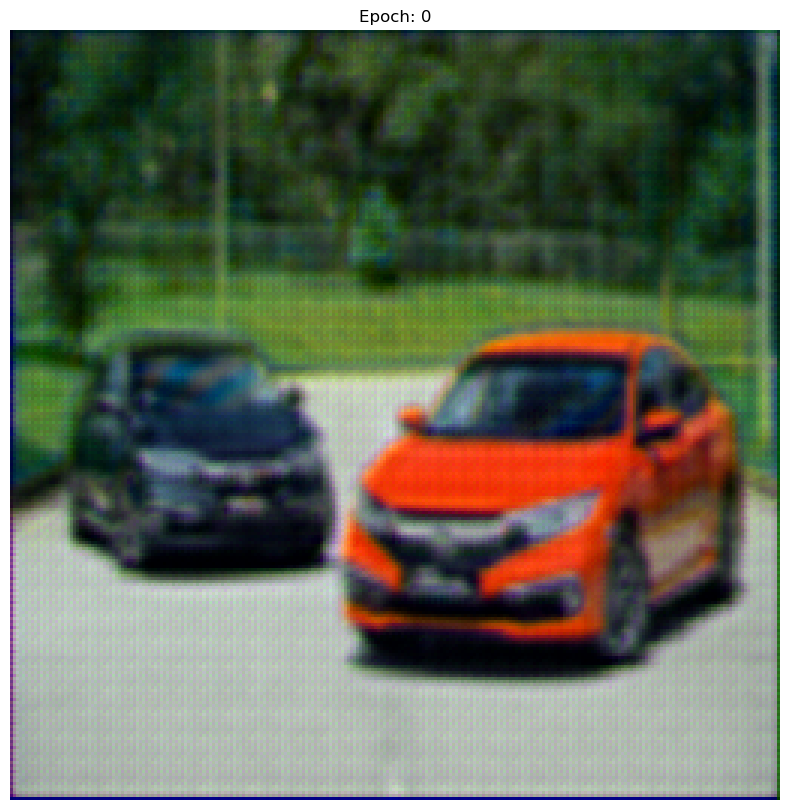

70/70 [==============================] - 10s 149ms/step - loss: 0.0557 - acc: 0.6441 - val_loss: 0.0543 - val_acc: 0.6264
Epoch 2/50
1/1 [==============================] - 0s 15ms/steploss: 0.0443 - acc: 0.68


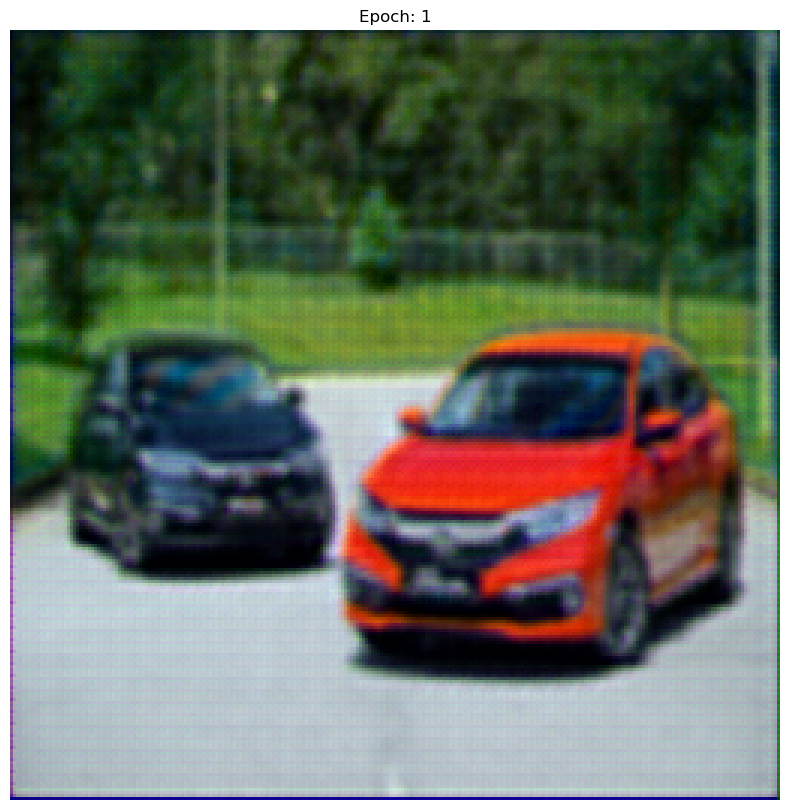

70/70 [==============================] - 10s 138ms/step - loss: 0.0443 - acc: 0.6818 - val_loss: 0.0458 - val_acc: 0.6575
Epoch 3/50
1/1 [==============================] - 0s 17ms/steploss: 0.0377 - acc: 0.71


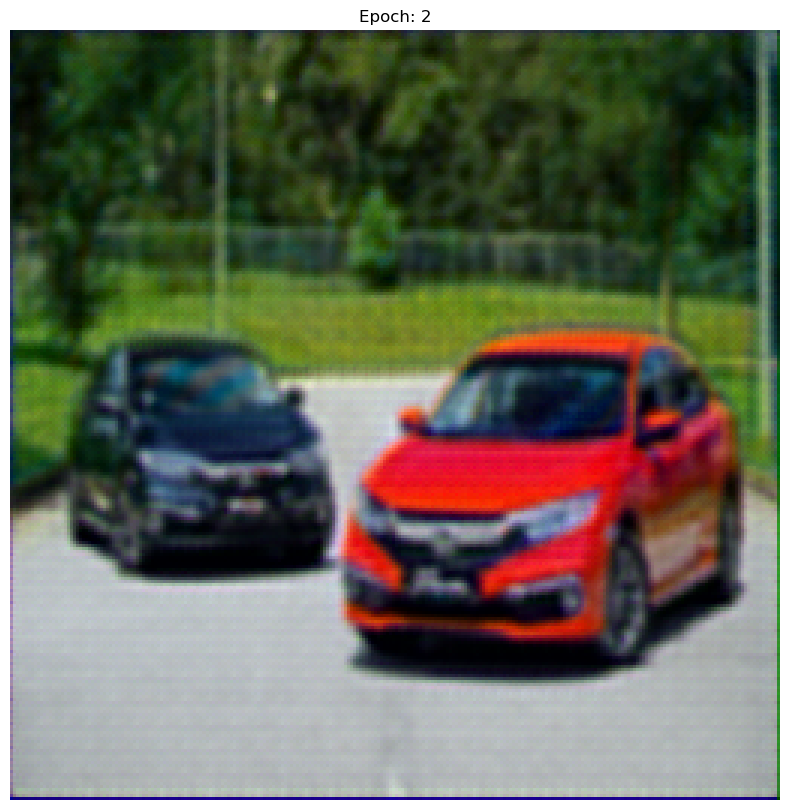

70/70 [==============================] - 10s 143ms/step - loss: 0.0377 - acc: 0.7149 - val_loss: 0.0391 - val_acc: 0.7416
Epoch 4/50
1/1 [==============================] - 0s 22ms/steploss: 0.0377 - acc: 0.70


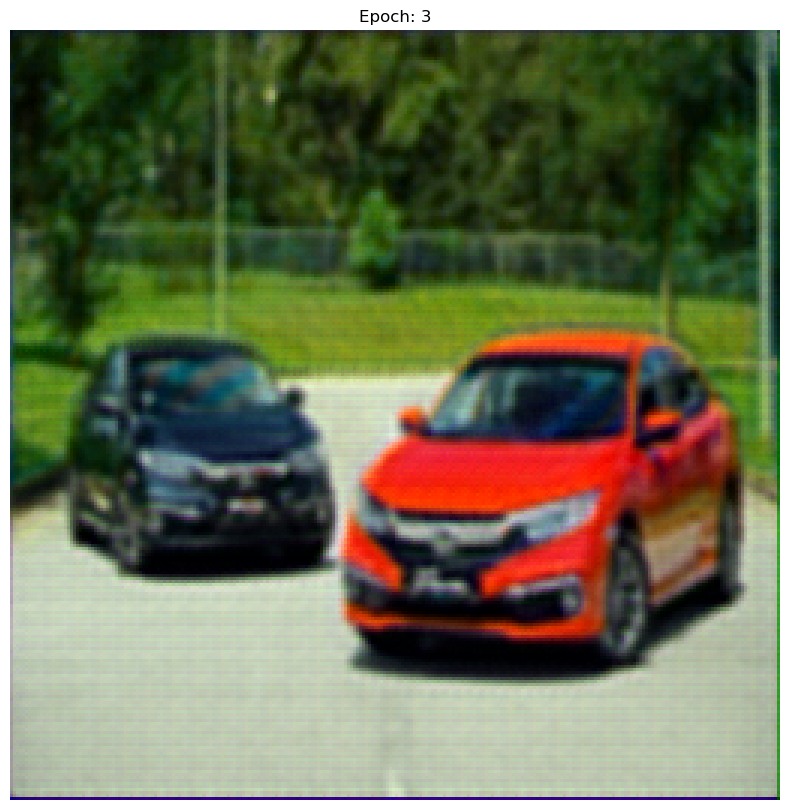

70/70 [==============================] - 10s 143ms/step - loss: 0.0377 - acc: 0.7034 - val_loss: 0.0390 - val_acc: 0.6466
Epoch 5/50
1/1 [==============================] - 0s 15ms/steploss: 0.0311 - acc: 0.74


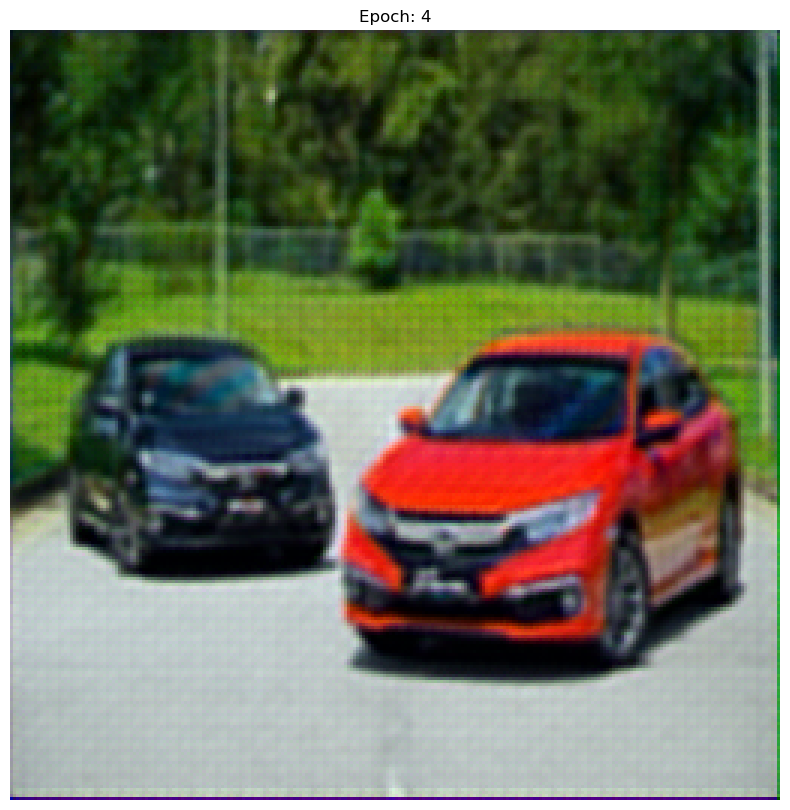

70/70 [==============================] - 10s 141ms/step - loss: 0.0311 - acc: 0.7424 - val_loss: 0.0326 - val_acc: 0.7218
Epoch 6/50
1/1 [==============================] - 0s 15ms/steploss: 0.0293 - acc: 0.75


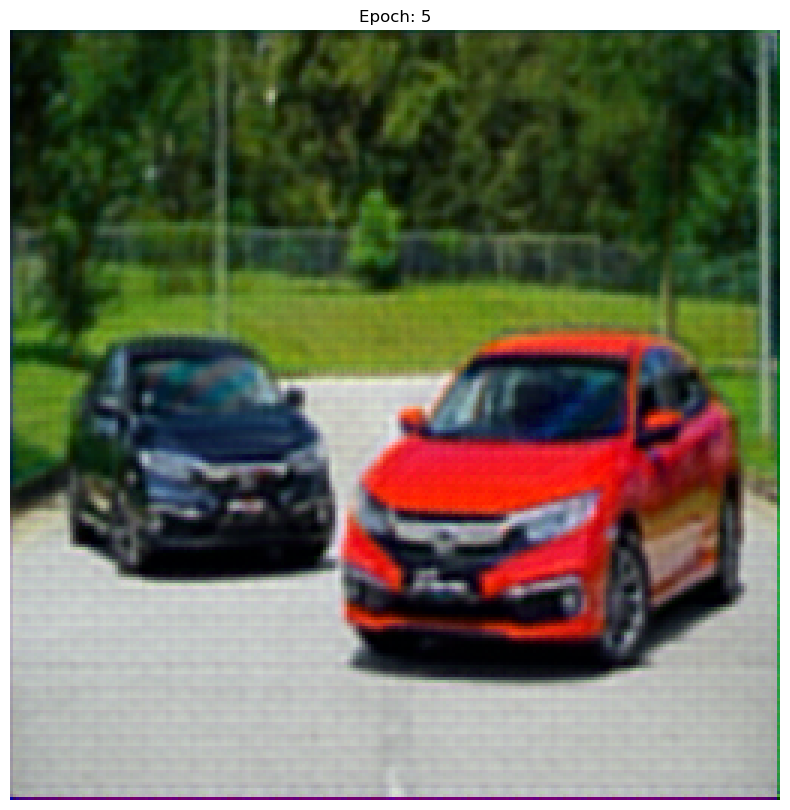

70/70 [==============================] - 10s 148ms/step - loss: 0.0293 - acc: 0.7570 - val_loss: 0.0295 - val_acc: 0.8183
Epoch 7/50
1/1 [==============================] - 0s 14ms/steploss: 0.0271 - acc: 0.77


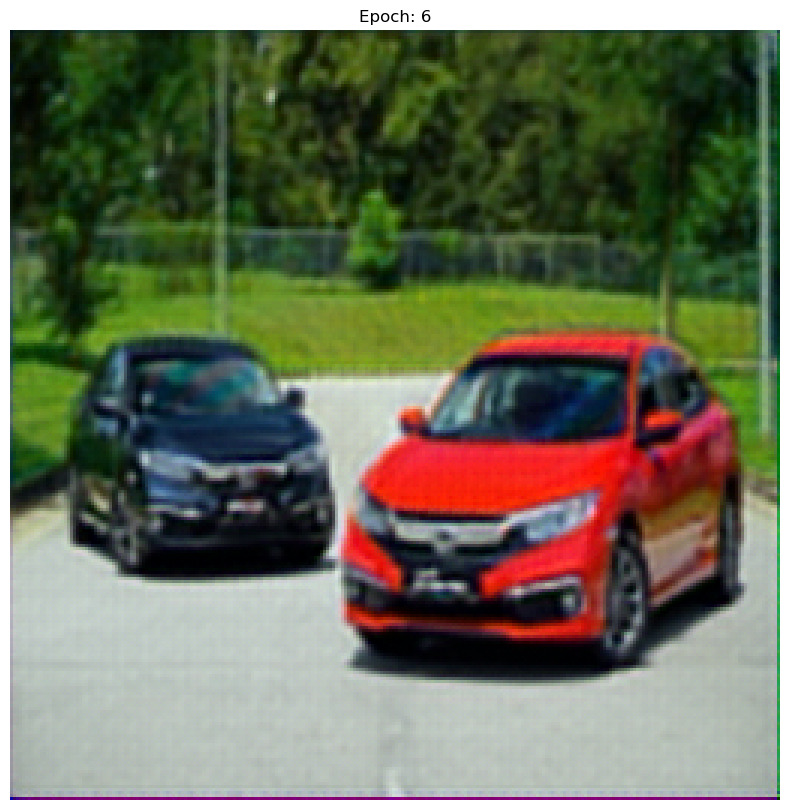

70/70 [==============================] - 10s 136ms/step - loss: 0.0271 - acc: 0.7732 - val_loss: 0.0260 - val_acc: 0.7774
Epoch 8/50
1/1 [==============================] - 0s 19ms/steploss: 0.0258 - acc: 0.78


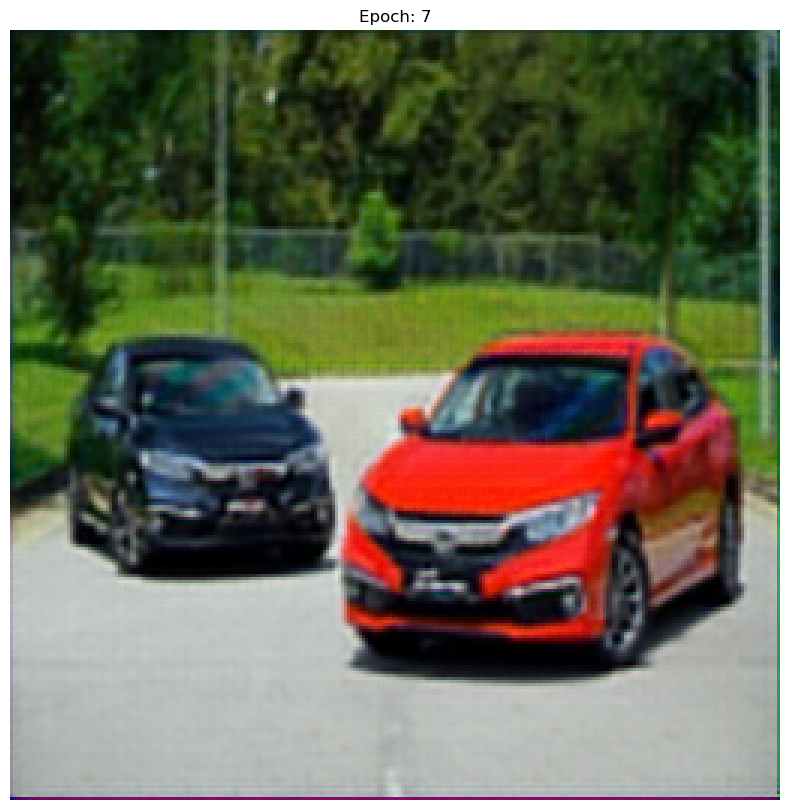

70/70 [==============================] - 10s 139ms/step - loss: 0.0258 - acc: 0.7869 - val_loss: 0.0273 - val_acc: 0.7989
Epoch 9/50
1/1 [==============================] - 0s 21ms/steploss: 0.0256 - acc: 0.77


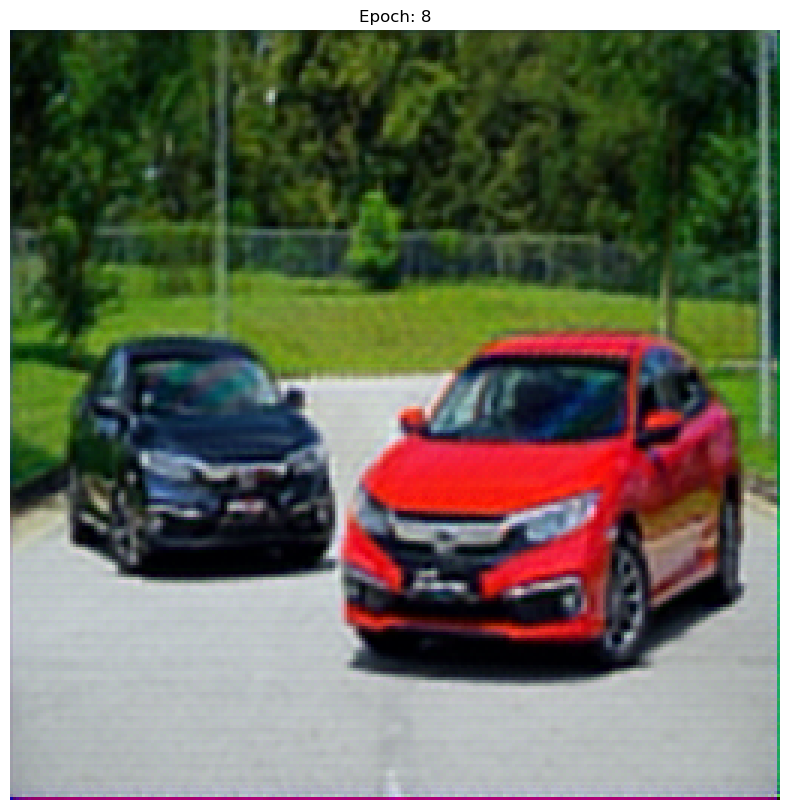

70/70 [==============================] - 10s 146ms/step - loss: 0.0256 - acc: 0.7787 - val_loss: 0.0269 - val_acc: 0.7636
Epoch 10/50
1/1 [==============================] - 0s 18ms/steploss: 0.0246 - acc: 0.78


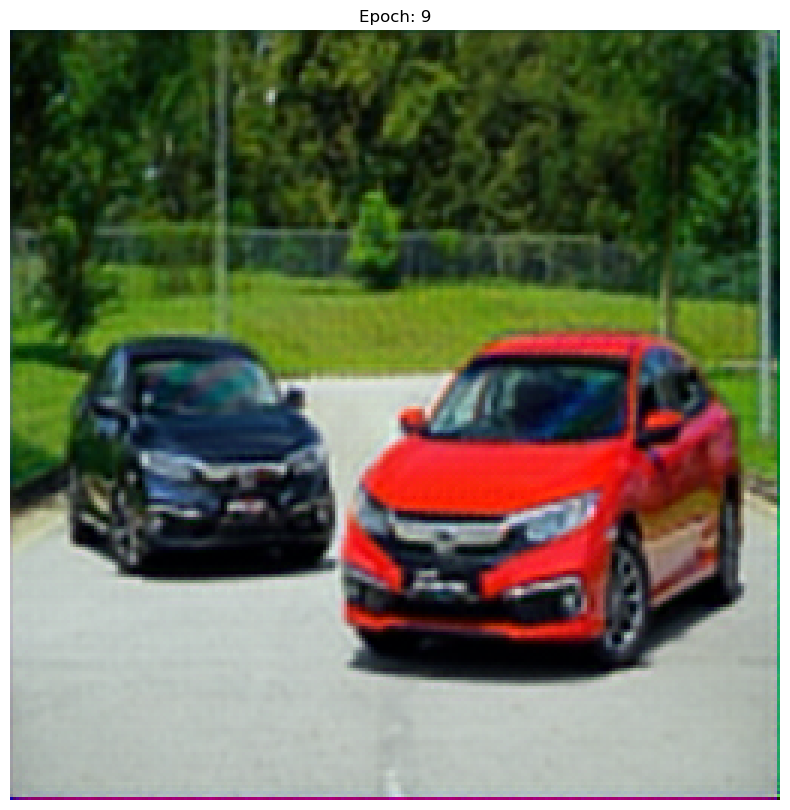

70/70 [==============================] - 11s 152ms/step - loss: 0.0246 - acc: 0.7855 - val_loss: 0.0231 - val_acc: 0.8088
Epoch 11/50
1/1 [==============================] - 0s 21ms/steploss: 0.0240 - acc: 0.79


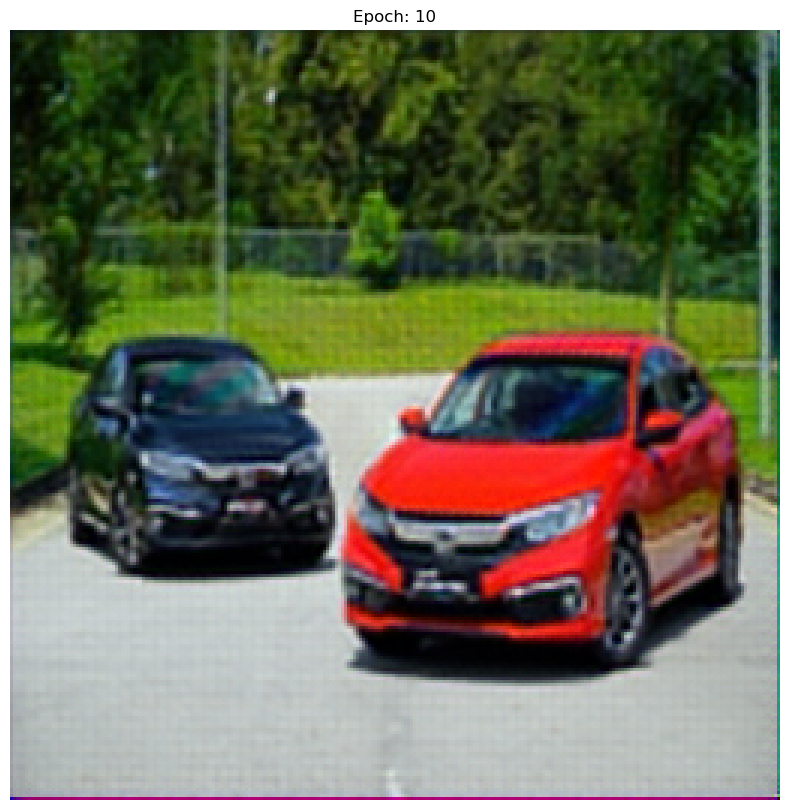

70/70 [==============================] - 10s 139ms/step - loss: 0.0240 - acc: 0.7957 - val_loss: 0.0254 - val_acc: 0.8003
Epoch 12/50
1/1 [==============================] - 0s 14ms/steploss: 0.0257 - acc: 0.76


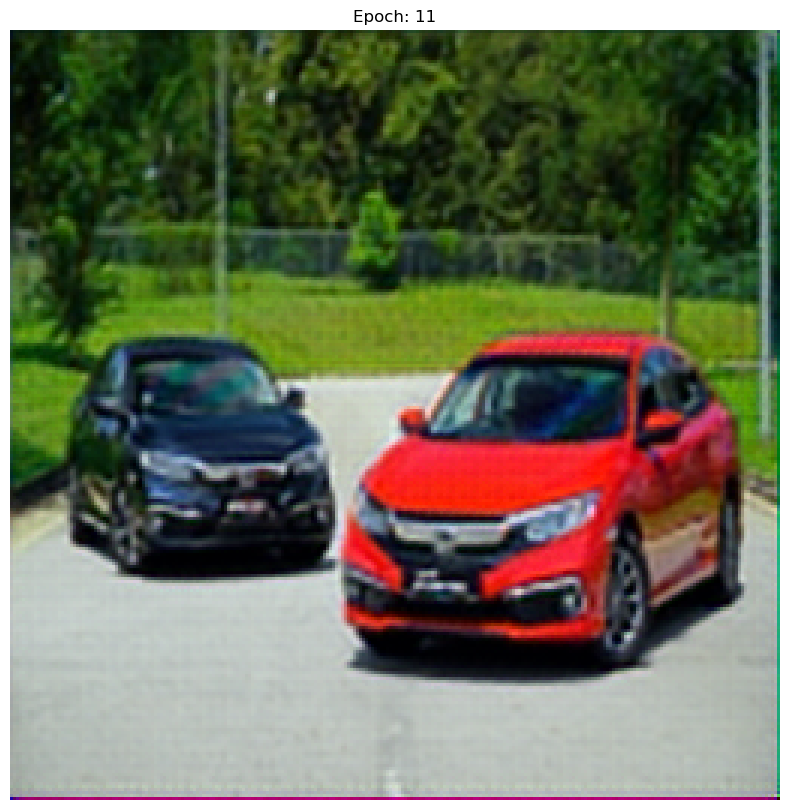

70/70 [==============================] - 10s 137ms/step - loss: 0.0257 - acc: 0.7686 - val_loss: 0.0231 - val_acc: 0.7922
Epoch 13/50
1/1 [==============================] - 0s 15ms/steploss: 0.0238 - acc: 0.79


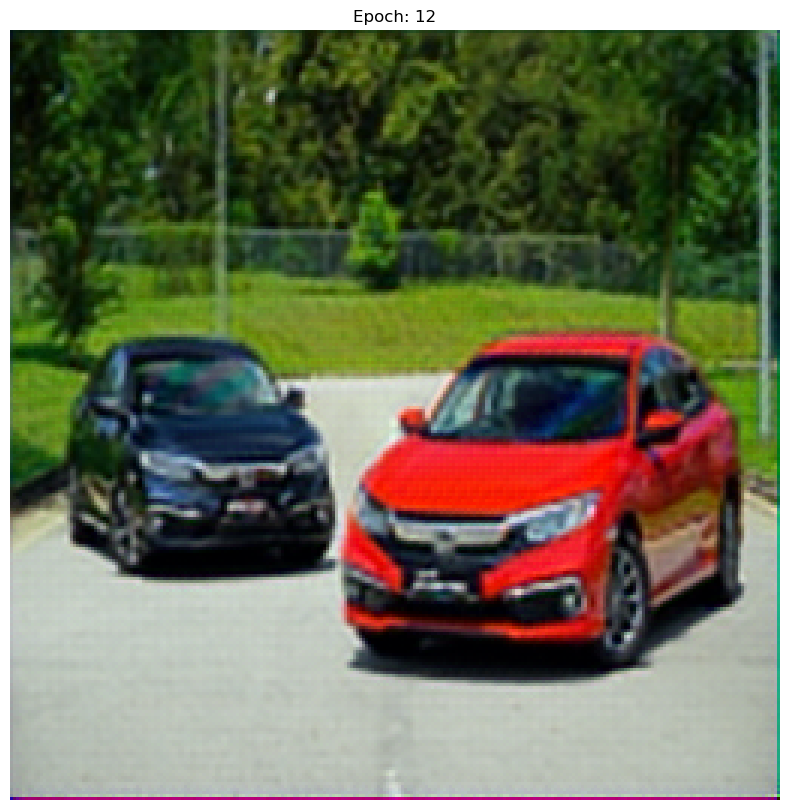

70/70 [==============================] - 10s 136ms/step - loss: 0.0238 - acc: 0.7908 - val_loss: 0.0228 - val_acc: 0.8353
Epoch 14/50
1/1 [==============================] - 0s 28ms/steploss: 0.0225 - acc: 0.81


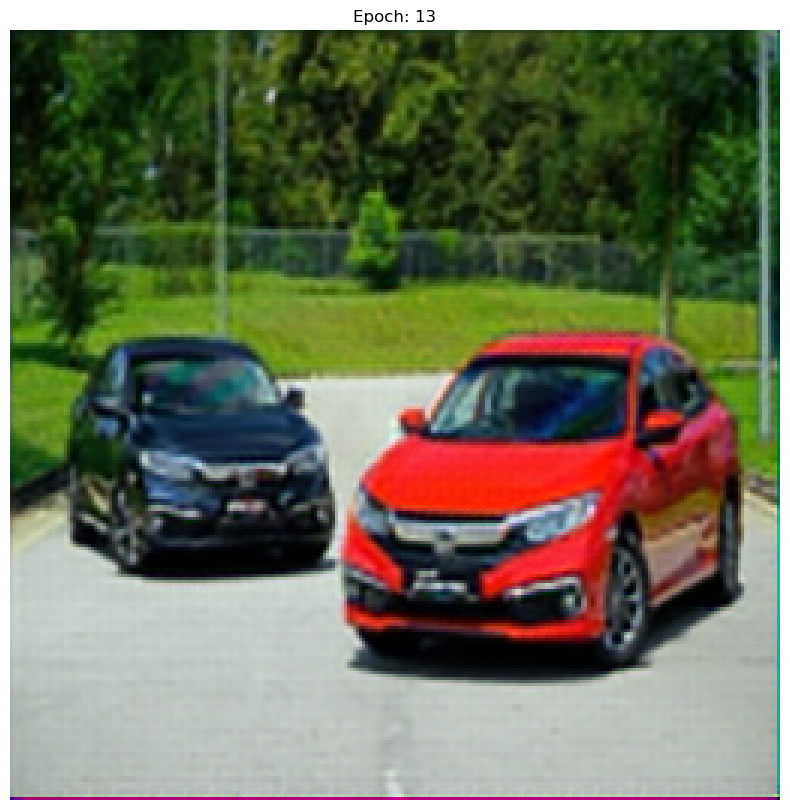

70/70 [==============================] - 10s 137ms/step - loss: 0.0225 - acc: 0.8104 - val_loss: 0.0231 - val_acc: 0.8174
Epoch 15/50
1/1 [==============================] - 0s 17ms/steploss: 0.0231 - acc: 0.79


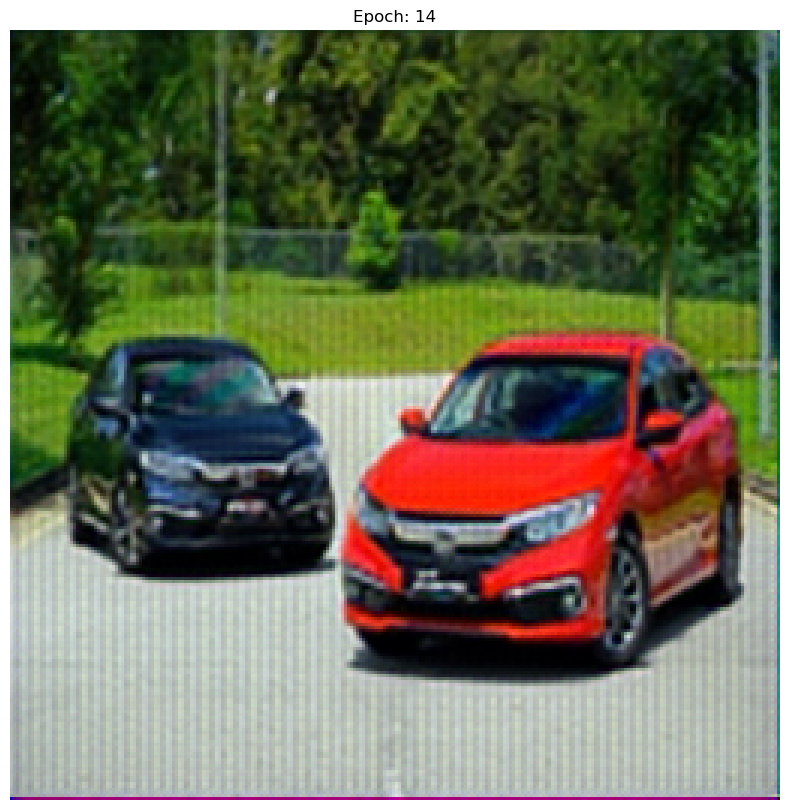

70/70 [==============================] - 9s 136ms/step - loss: 0.0231 - acc: 0.7919 - val_loss: 0.0283 - val_acc: 0.7977
Epoch 16/50
1/1 [==============================] - 0s 17ms/steploss: 0.0230 - acc: 0.79


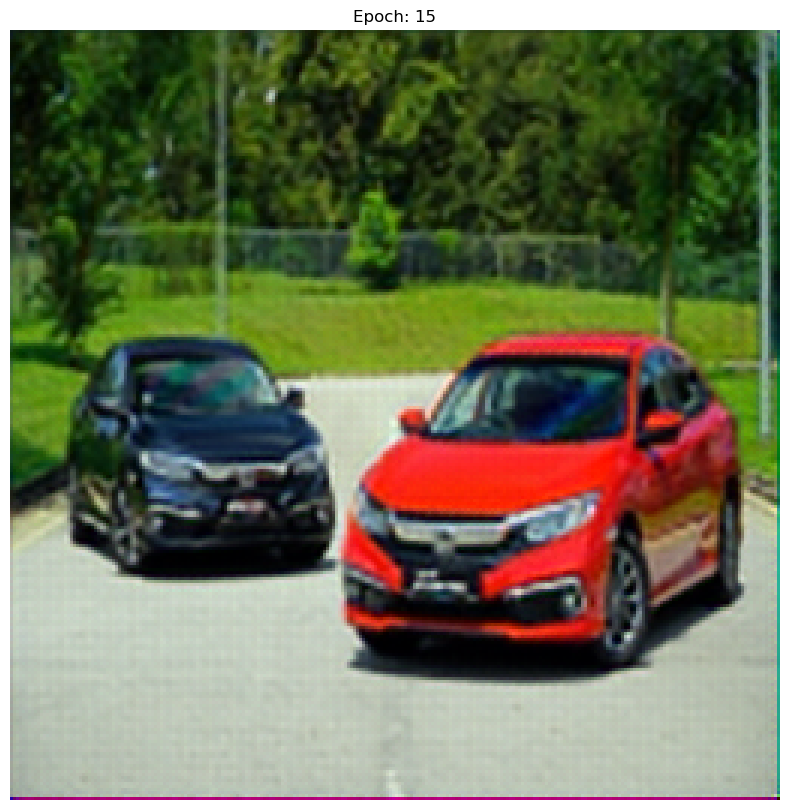

70/70 [==============================] - 10s 136ms/step - loss: 0.0230 - acc: 0.7995 - val_loss: 0.0239 - val_acc: 0.7820
Epoch 17/50
1/1 [==============================] - 0s 14ms/steploss: 0.0224 - acc: 0.79


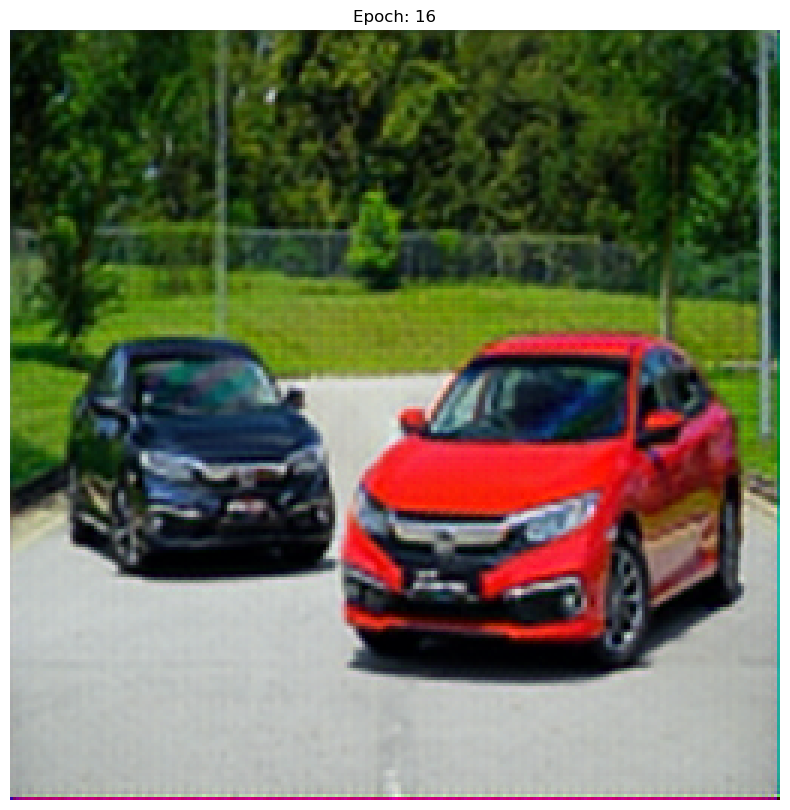

70/70 [==============================] - 10s 136ms/step - loss: 0.0224 - acc: 0.7959 - val_loss: 0.0226 - val_acc: 0.8259
Epoch 18/50
1/1 [==============================] - 0s 14ms/steploss: 0.0213 - acc: 0.81


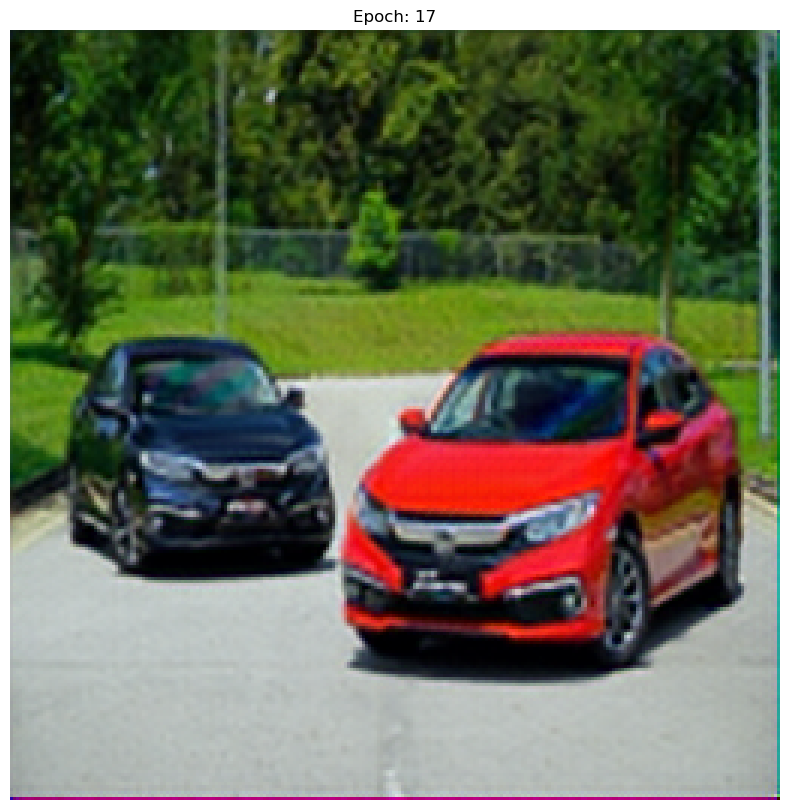

70/70 [==============================] - 10s 137ms/step - loss: 0.0213 - acc: 0.8100 - val_loss: 0.0232 - val_acc: 0.7979
Epoch 19/50
1/1 [==============================] - 0s 14ms/steploss: 0.0207 - acc: 0.81


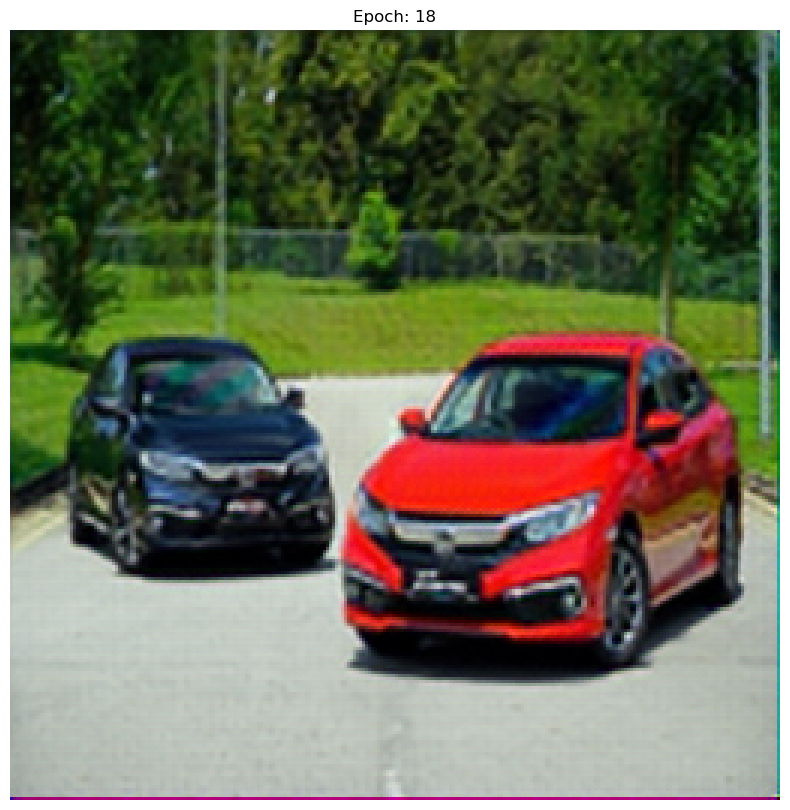

70/70 [==============================] - 10s 136ms/step - loss: 0.0207 - acc: 0.8170 - val_loss: 0.0207 - val_acc: 0.8442
Epoch 20/50
1/1 [==============================] - 0s 25ms/steploss: 0.0211 - acc: 0.80


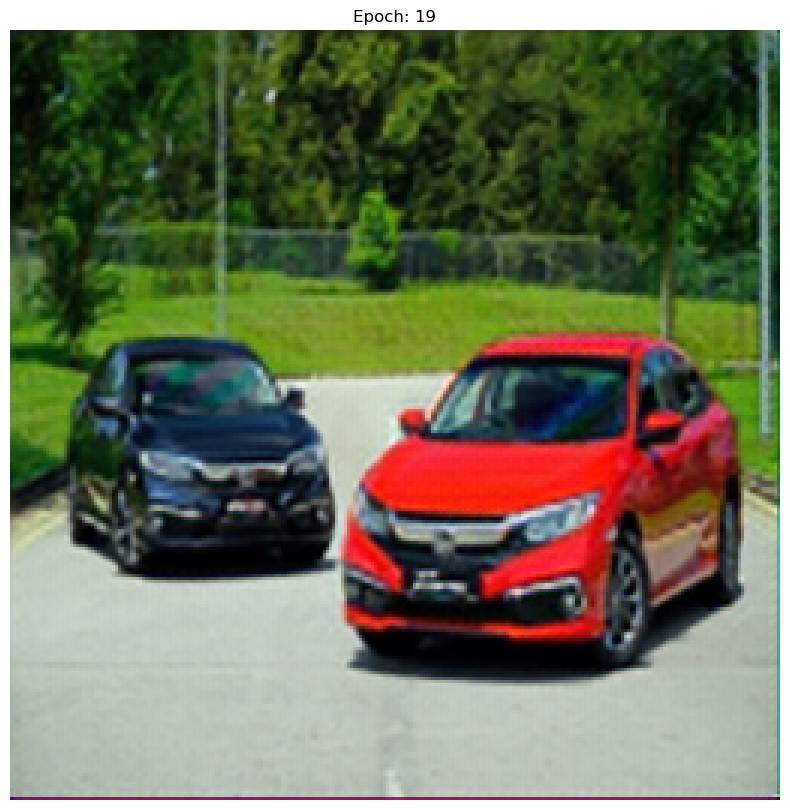

70/70 [==============================] - 10s 148ms/step - loss: 0.0211 - acc: 0.8068 - val_loss: 0.0211 - val_acc: 0.8001
Epoch 21/50
1/1 [==============================] - 0s 14ms/steploss: 0.0212 - acc: 0.81


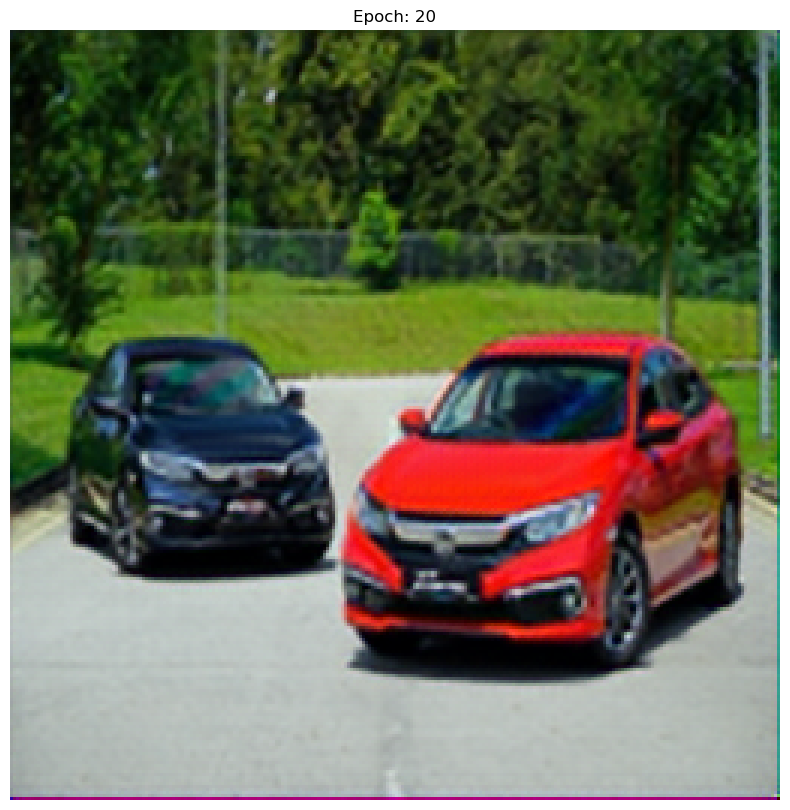

70/70 [==============================] - 10s 138ms/step - loss: 0.0212 - acc: 0.8116 - val_loss: 0.0222 - val_acc: 0.8034
Epoch 22/50
1/1 [==============================] - 0s 22ms/steploss: 0.0207 - acc: 0.82


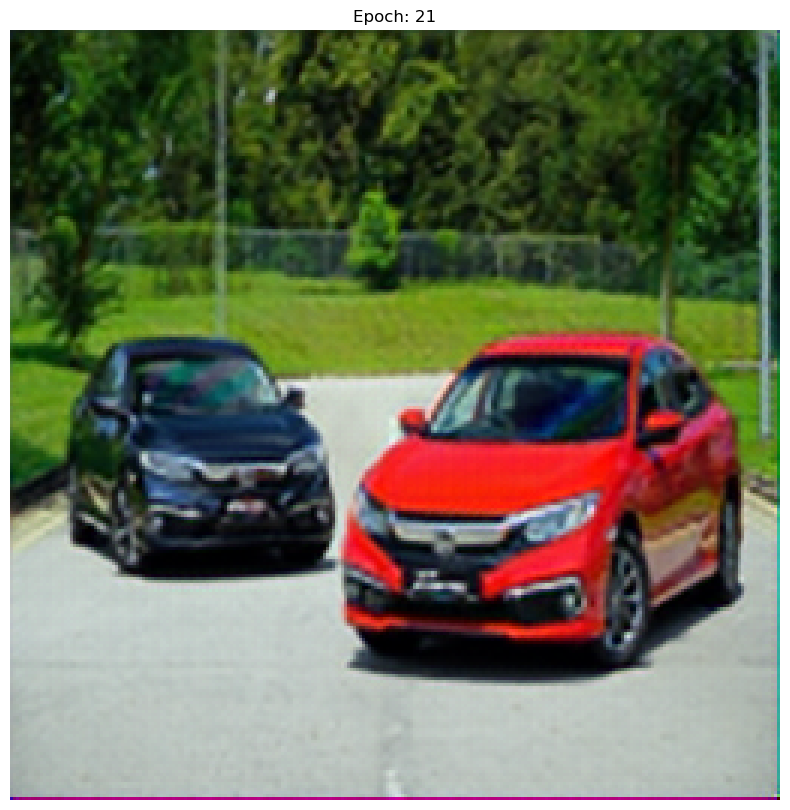

70/70 [==============================] - 10s 138ms/step - loss: 0.0207 - acc: 0.8206 - val_loss: 0.0211 - val_acc: 0.8039
Epoch 23/50
1/1 [==============================] - 0s 42ms/steploss: 0.0203 - acc: 0.81


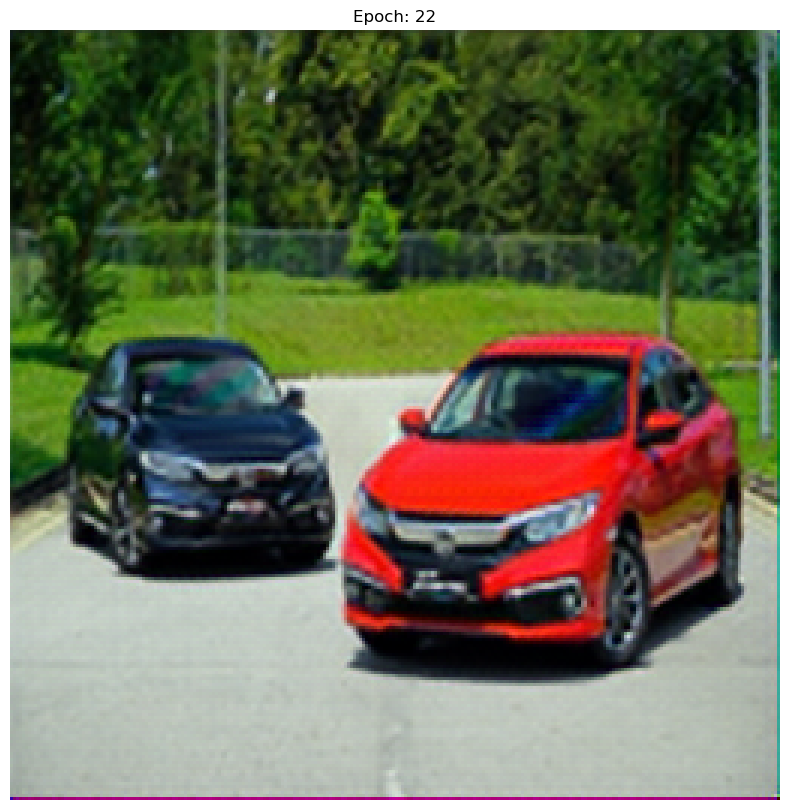

70/70 [==============================] - 10s 137ms/step - loss: 0.0203 - acc: 0.8191 - val_loss: 0.0202 - val_acc: 0.8238
Epoch 24/50
1/1 [==============================] - 0s 17ms/steploss: 0.0211 - acc: 0.81


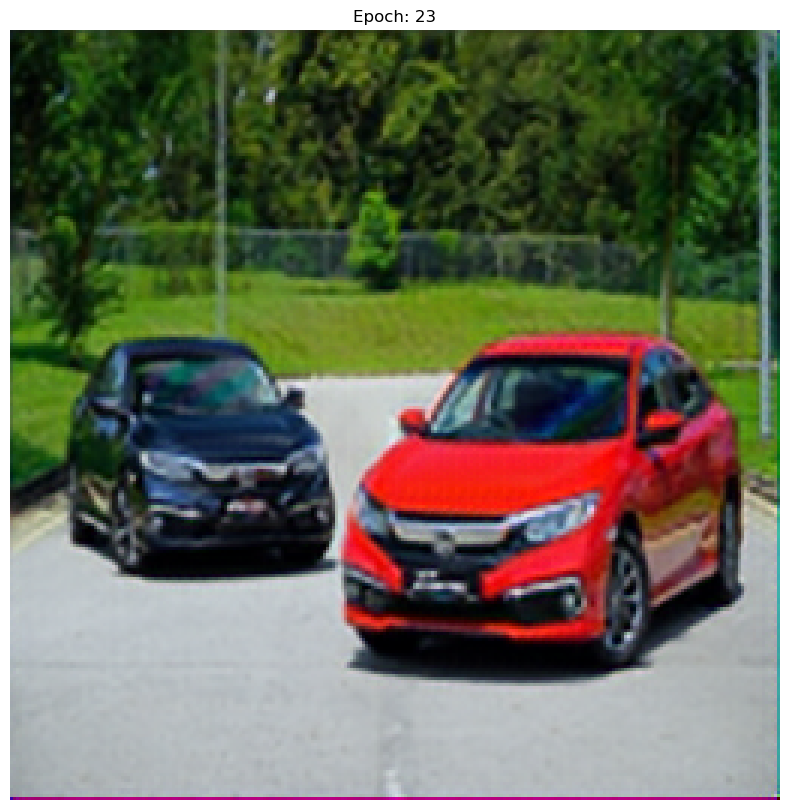

70/70 [==============================] - 9s 135ms/step - loss: 0.0211 - acc: 0.8145 - val_loss: 0.0243 - val_acc: 0.7755
Epoch 25/50
1/1 [==============================] - 0s 14ms/steploss: 0.0207 - acc: 0.81


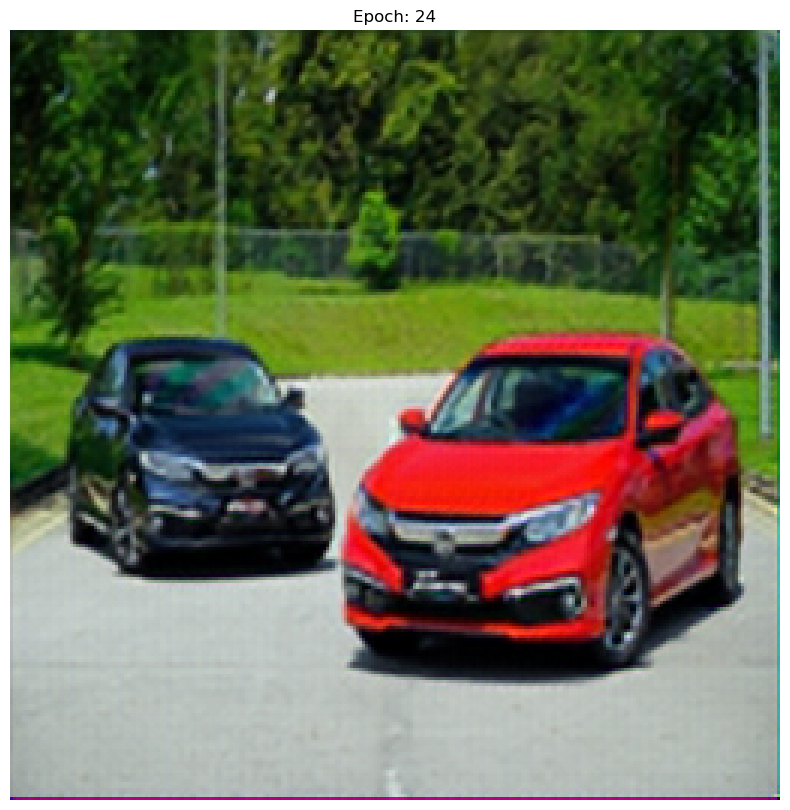

70/70 [==============================] - 10s 136ms/step - loss: 0.0207 - acc: 0.8118 - val_loss: 0.0208 - val_acc: 0.8117
Epoch 26/50
1/1 [==============================] - 0s 16ms/steploss: 0.0197 - acc: 0.82


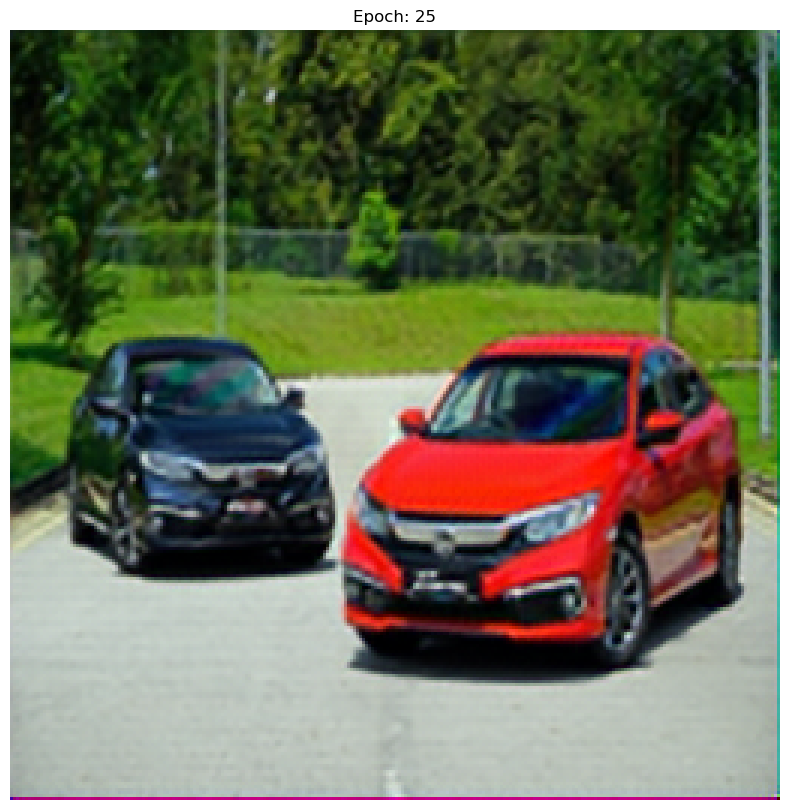

70/70 [==============================] - 10s 141ms/step - loss: 0.0197 - acc: 0.8203 - val_loss: 0.0198 - val_acc: 0.8135
Epoch 27/50
1/1 [==============================] - 0s 44ms/steploss: 0.0200 - acc: 0.82


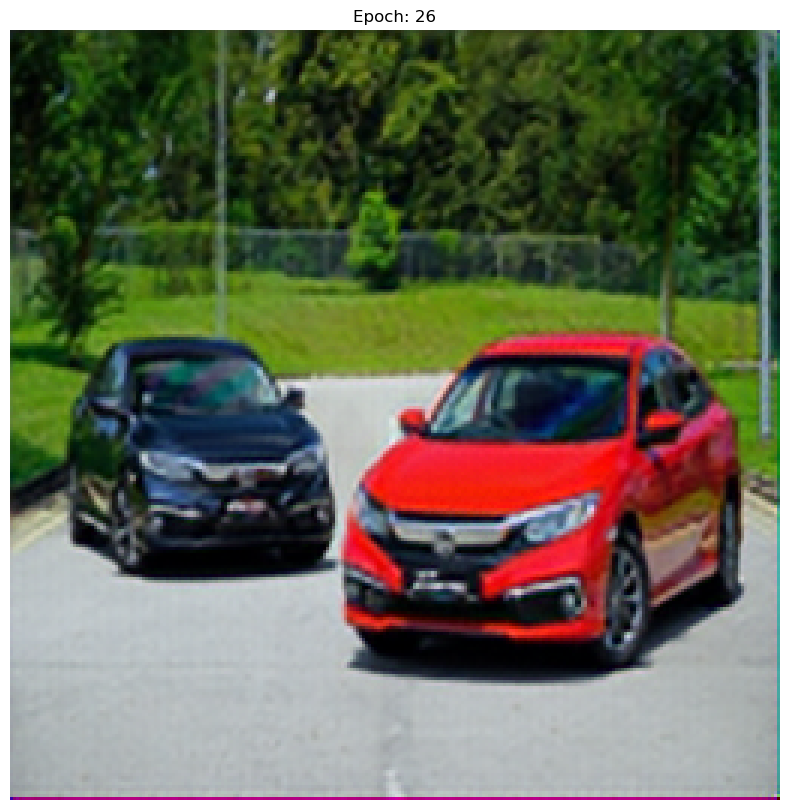

70/70 [==============================] - 10s 138ms/step - loss: 0.0200 - acc: 0.8200 - val_loss: 0.0241 - val_acc: 0.7794
Epoch 28/50
1/1 [==============================] - 0s 15ms/steploss: 0.0199 - acc: 0.82


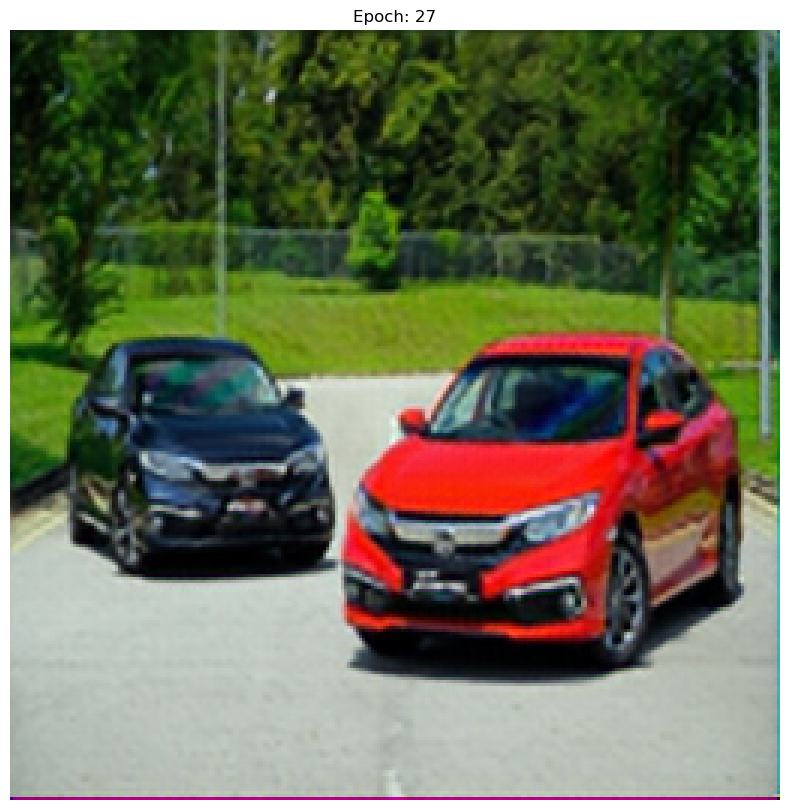

70/70 [==============================] - 10s 136ms/step - loss: 0.0199 - acc: 0.8217 - val_loss: 0.0192 - val_acc: 0.8400
Epoch 29/50
1/1 [==============================] - 0s 14ms/steploss: 0.0200 - acc: 0.83


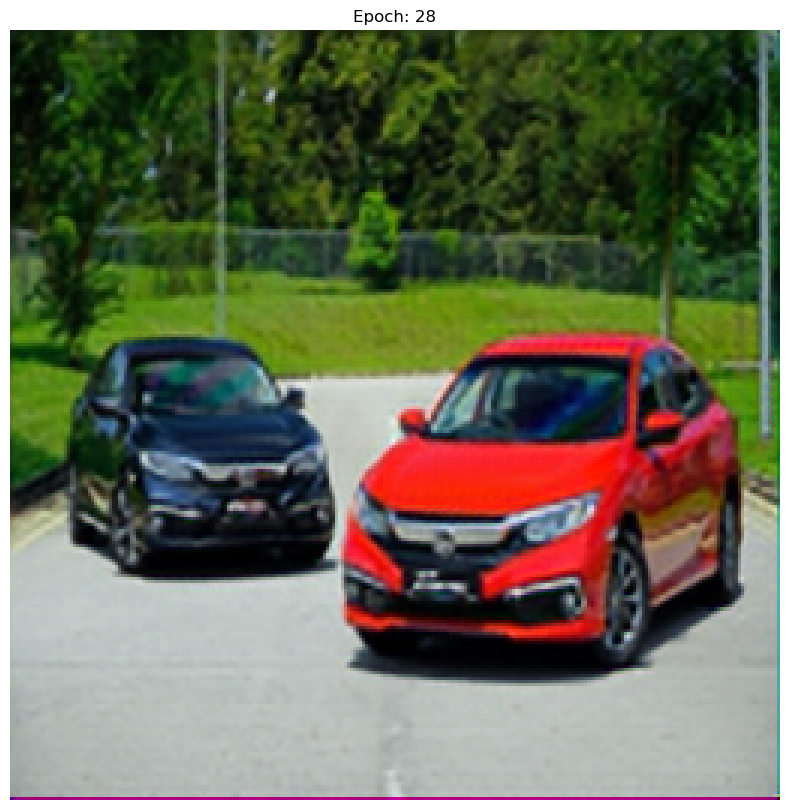

70/70 [==============================] - 10s 136ms/step - loss: 0.0200 - acc: 0.8314 - val_loss: 0.0209 - val_acc: 0.8062
Epoch 30/50
1/1 [==============================] - 0s 14ms/steploss: 0.0196 - acc: 0.82


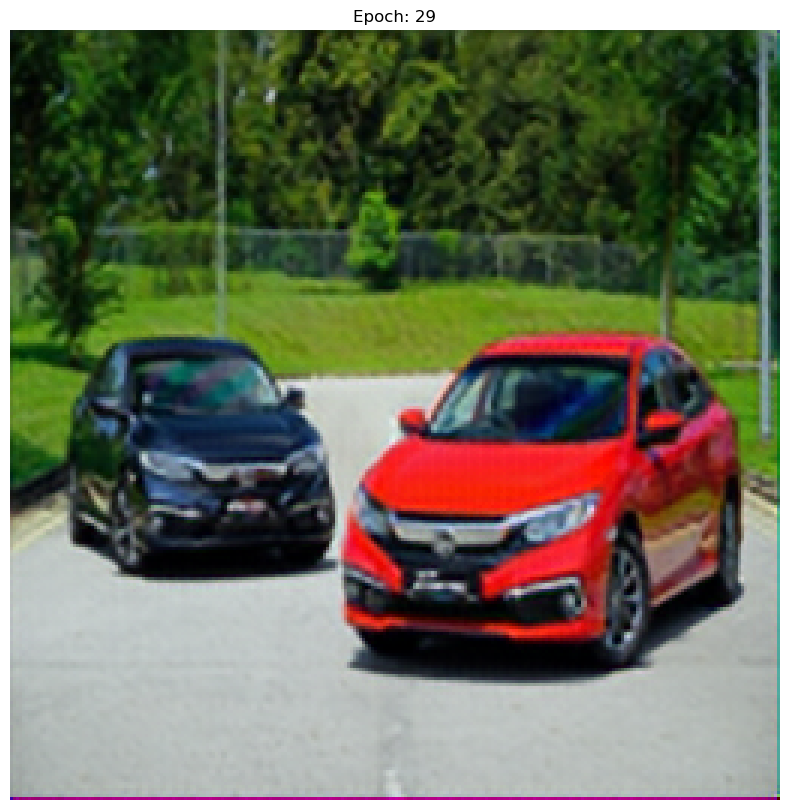

70/70 [==============================] - 9s 136ms/step - loss: 0.0196 - acc: 0.8228 - val_loss: 0.0206 - val_acc: 0.8022
Epoch 31/50
1/1 [==============================] - 0s 16ms/steploss: 0.0192 - acc: 0.82


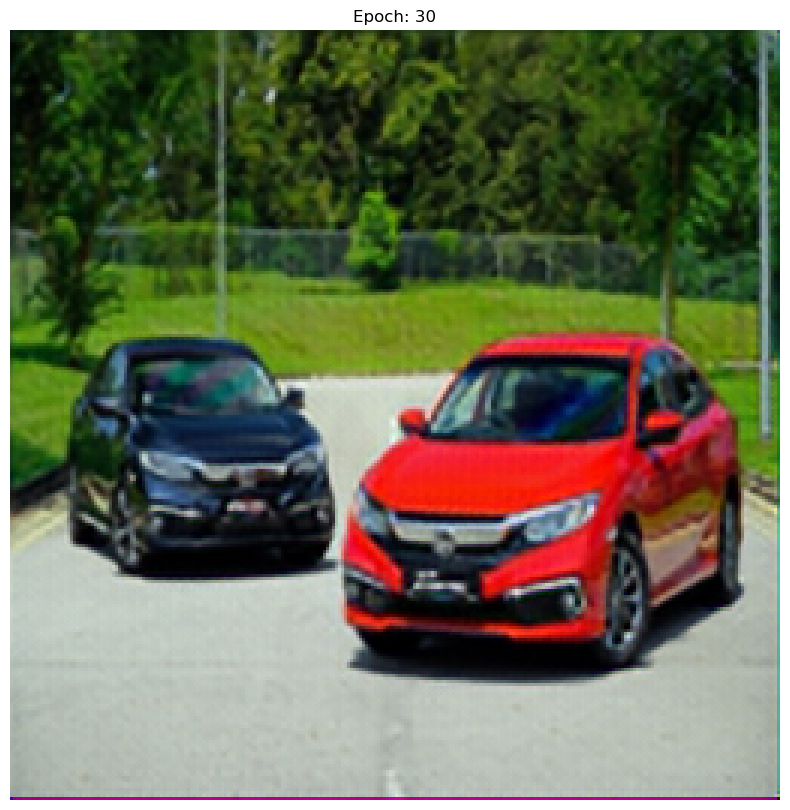

70/70 [==============================] - 10s 136ms/step - loss: 0.0192 - acc: 0.8263 - val_loss: 0.0197 - val_acc: 0.8348
Epoch 32/50
1/1 [==============================] - 0s 25ms/steploss: 0.0193 - acc: 0.82


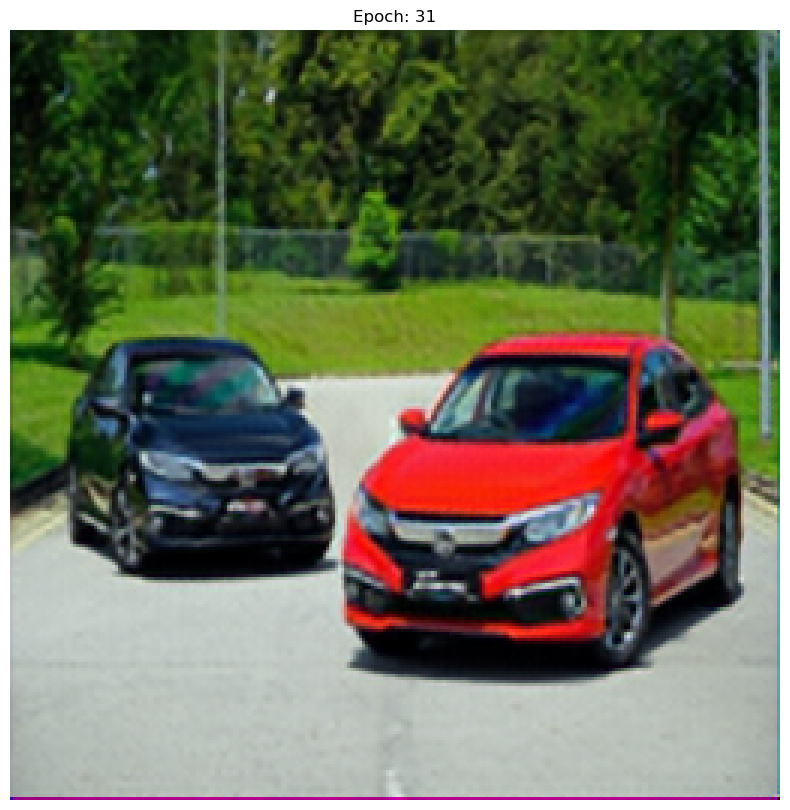

70/70 [==============================] - 10s 136ms/step - loss: 0.0193 - acc: 0.8247 - val_loss: 0.0191 - val_acc: 0.8179
Epoch 33/50
1/1 [==============================] - 0s 18ms/steploss: 0.0194 - acc: 0.81


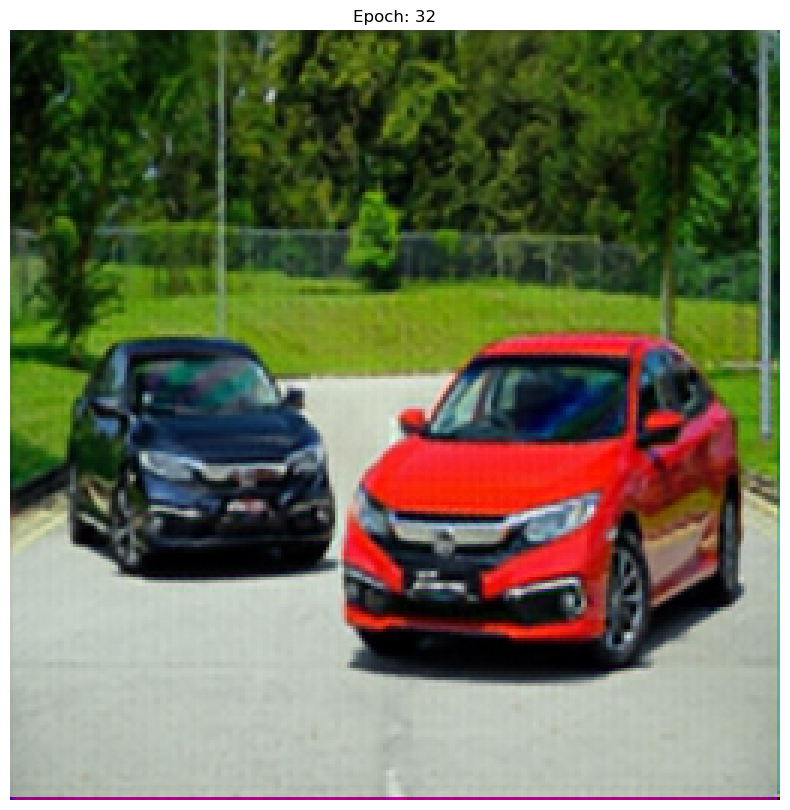

70/70 [==============================] - 10s 138ms/step - loss: 0.0194 - acc: 0.8130 - val_loss: 0.0197 - val_acc: 0.8336
Epoch 34/50
1/1 [==============================] - 0s 21ms/steploss: 0.0192 - acc: 0.81


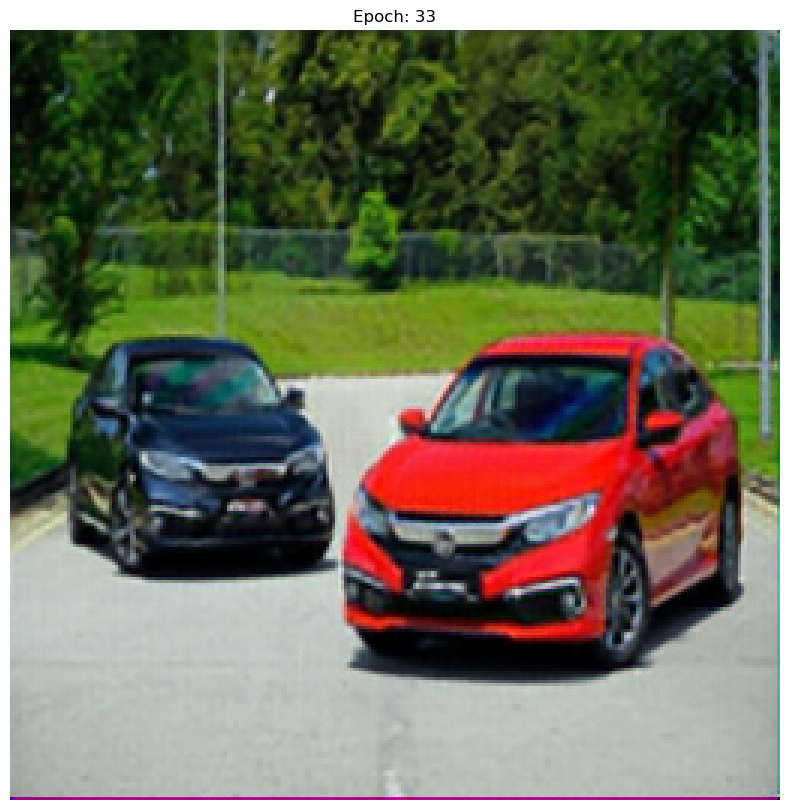

70/70 [==============================] - 10s 138ms/step - loss: 0.0192 - acc: 0.8157 - val_loss: 0.0200 - val_acc: 0.8128
Epoch 35/50
1/1 [==============================] - 0s 15ms/steploss: 0.0188 - acc: 0.82


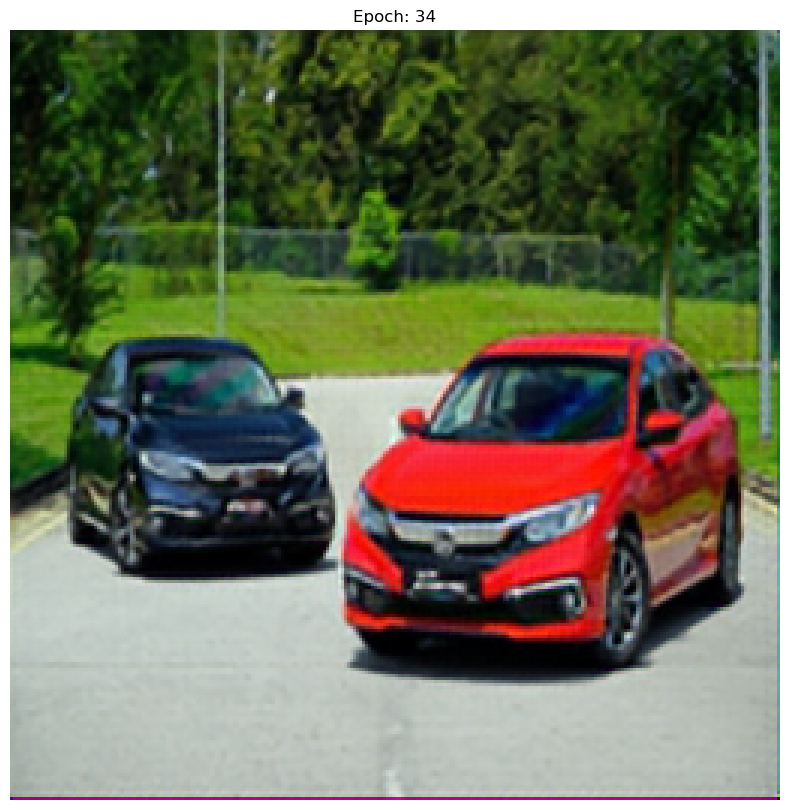

70/70 [==============================] - 10s 138ms/step - loss: 0.0188 - acc: 0.8219 - val_loss: 0.0195 - val_acc: 0.8238
Epoch 36/50
1/1 [==============================] - 0s 14ms/steploss: 0.0184 - acc: 0.83


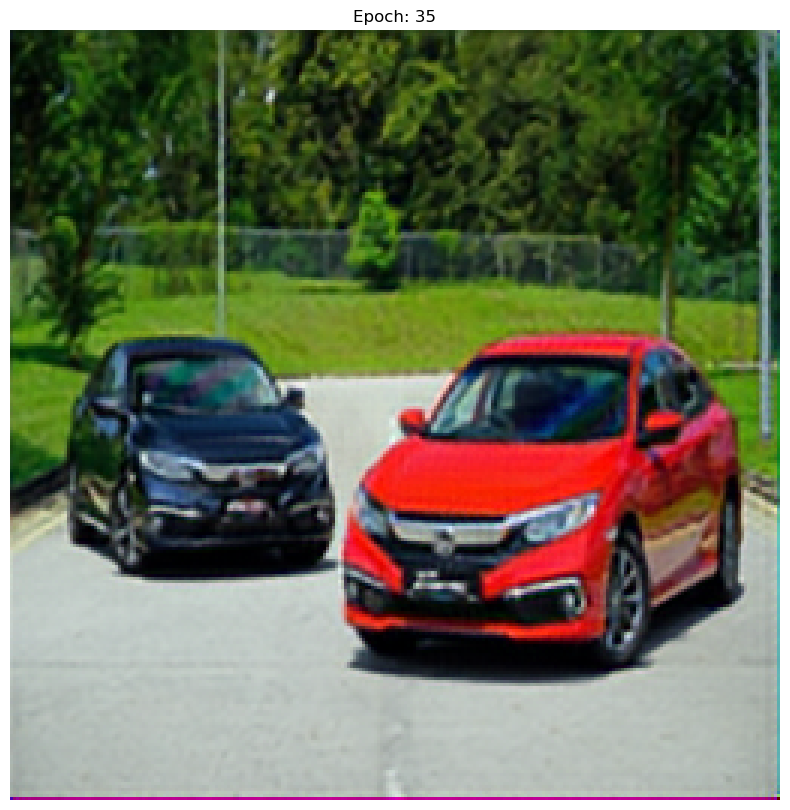

70/70 [==============================] - 10s 137ms/step - loss: 0.0184 - acc: 0.8375 - val_loss: 0.0197 - val_acc: 0.8091
Epoch 37/50
1/1 [==============================] - 0s 31ms/steploss: 0.0180 - acc: 0.82


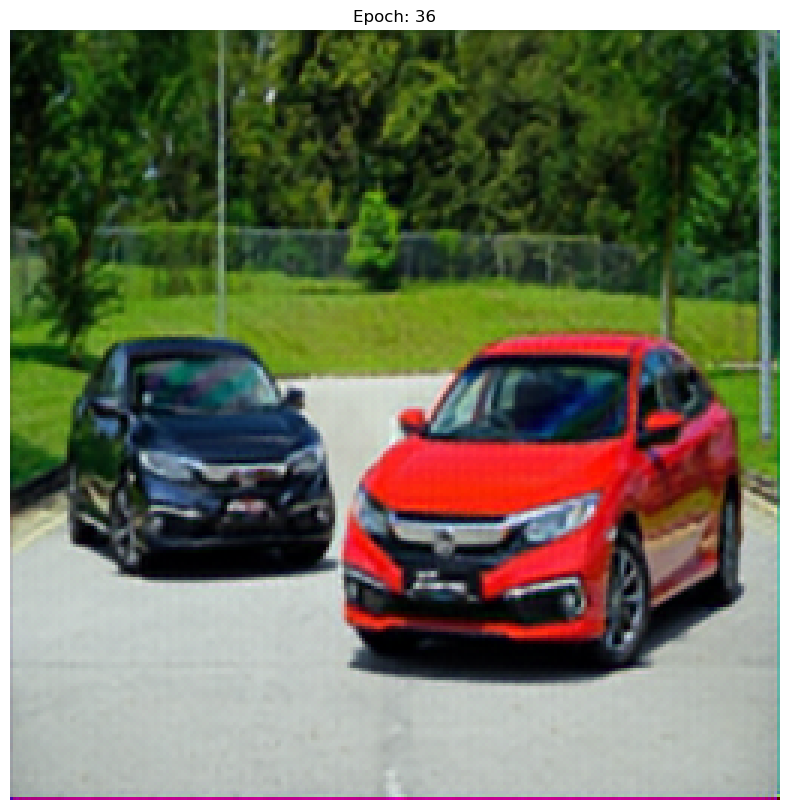

70/70 [==============================] - 10s 138ms/step - loss: 0.0180 - acc: 0.8294 - val_loss: 0.0201 - val_acc: 0.8102
Epoch 38/50
1/1 [==============================] - 0s 14ms/steploss: 0.0186 - acc: 0.81


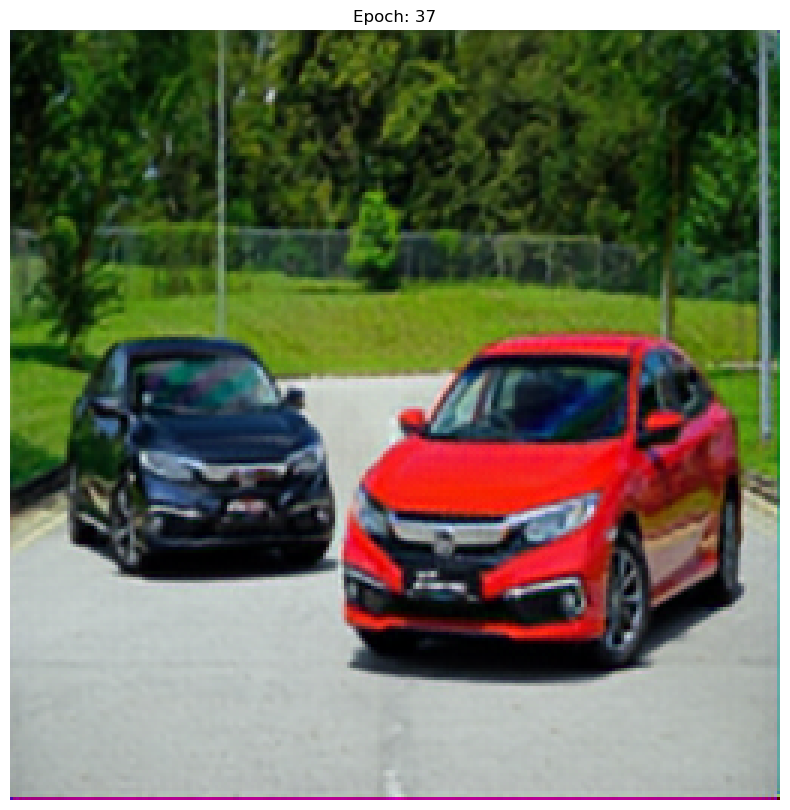

70/70 [==============================] - 10s 137ms/step - loss: 0.0186 - acc: 0.8110 - val_loss: 0.0203 - val_acc: 0.8138
Epoch 39/50
1/1 [==============================] - 0s 24ms/steploss: 0.0176 - acc: 0.82


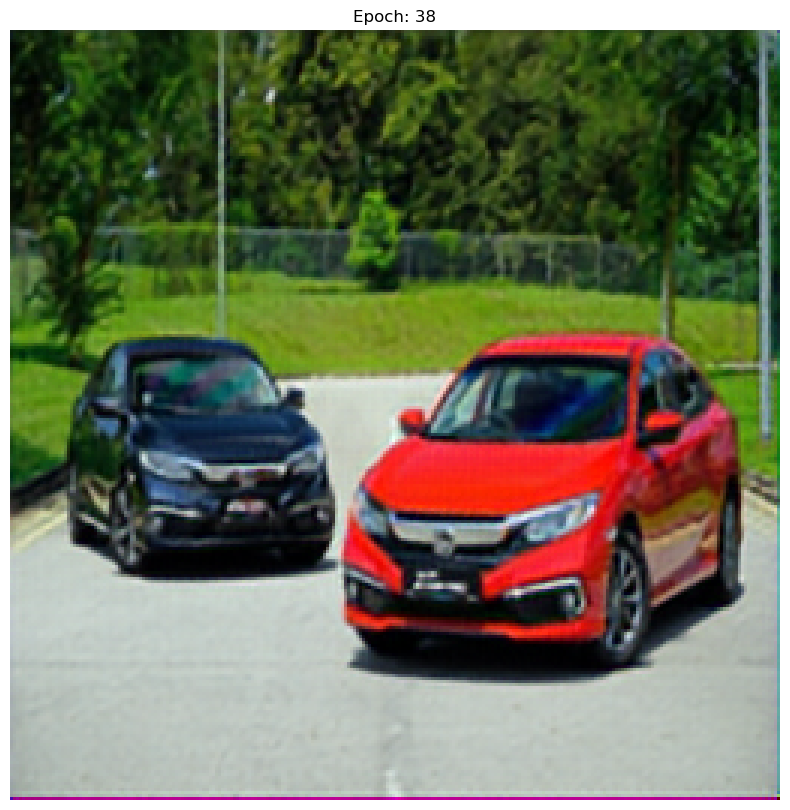

70/70 [==============================] - 10s 137ms/step - loss: 0.0176 - acc: 0.8237 - val_loss: 0.0202 - val_acc: 0.8210
Epoch 40/50
1/1 [==============================] - 0s 15ms/steploss: 0.0178 - acc: 0.82


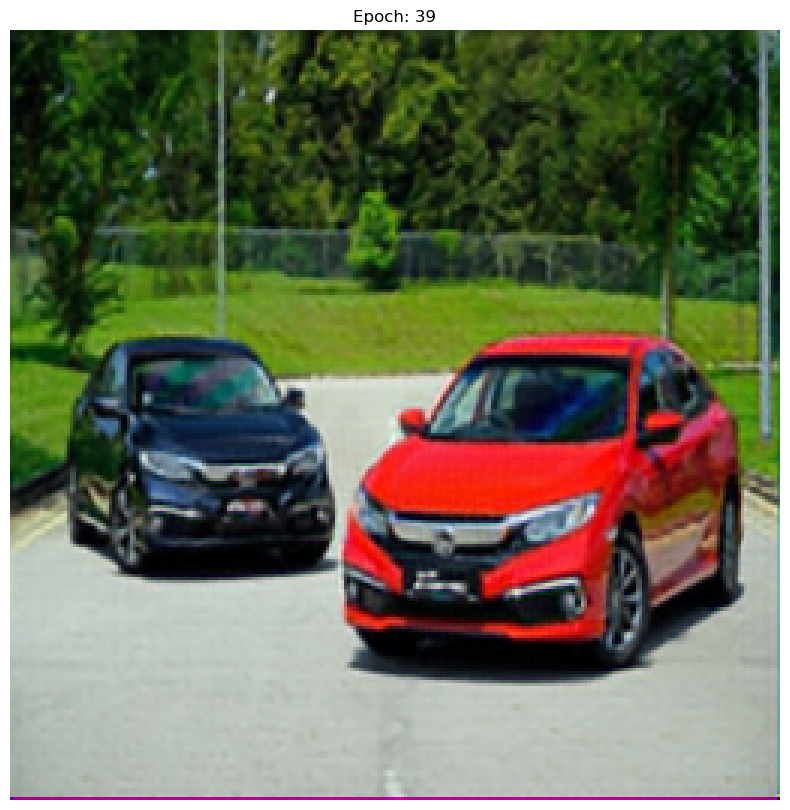

70/70 [==============================] - 10s 136ms/step - loss: 0.0178 - acc: 0.8259 - val_loss: 0.0189 - val_acc: 0.8388
Epoch 41/50
1/1 [==============================] - 0s 50ms/steploss: 0.0177 - acc: 0.82


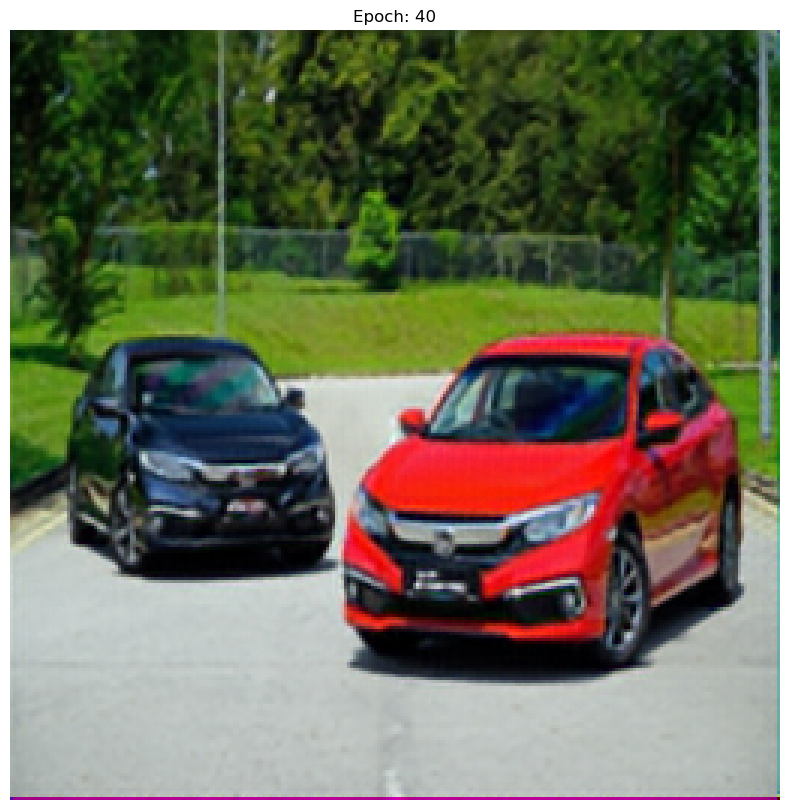

70/70 [==============================] - 10s 140ms/step - loss: 0.0177 - acc: 0.8256 - val_loss: 0.0203 - val_acc: 0.8082
Epoch 42/50
1/1 [==============================] - 0s 15ms/steploss: 0.0179 - acc: 0.81


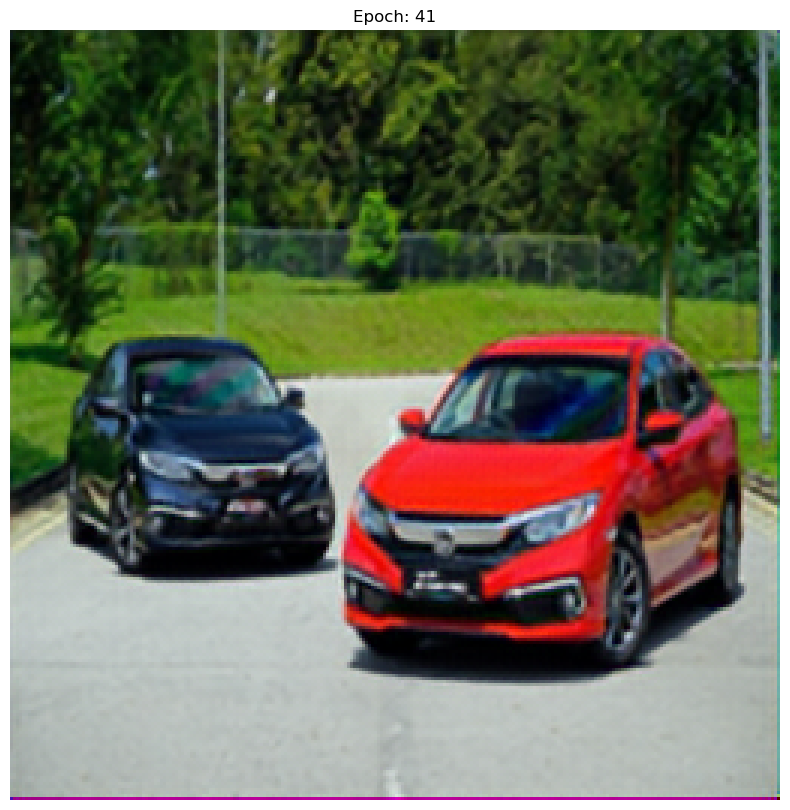

70/70 [==============================] - 10s 137ms/step - loss: 0.0179 - acc: 0.8143 - val_loss: 0.0199 - val_acc: 0.8052
Epoch 43/50
1/1 [==============================] - 0s 17ms/steploss: 0.0174 - acc: 0.83


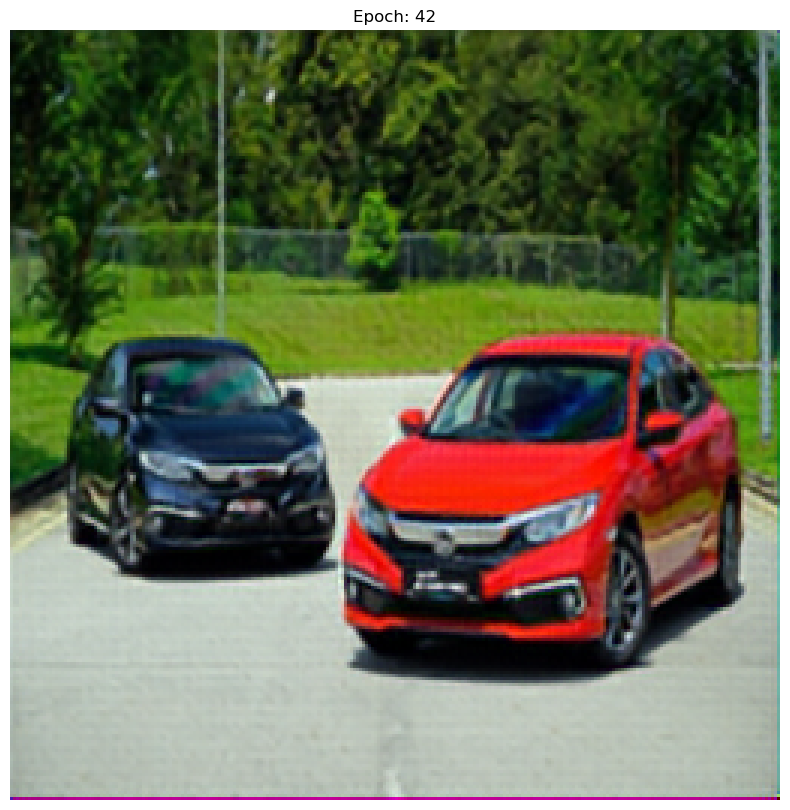

70/70 [==============================] - 10s 137ms/step - loss: 0.0174 - acc: 0.8318 - val_loss: 0.0199 - val_acc: 0.8102
Epoch 44/50
1/1 [==============================] - 0s 15ms/steploss: 0.0167 - acc: 0.83


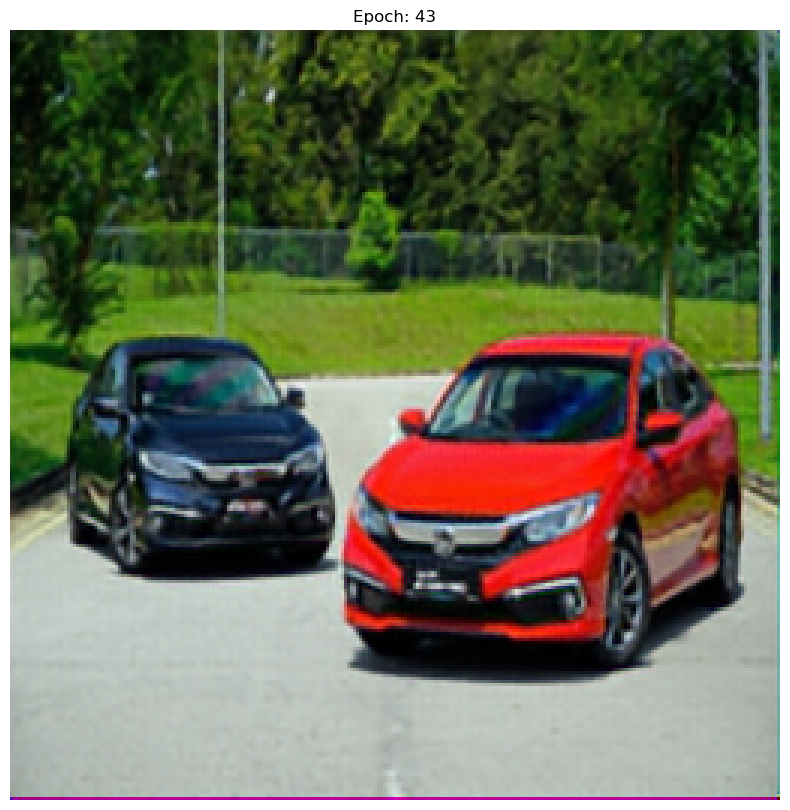

70/70 [==============================] - 10s 137ms/step - loss: 0.0167 - acc: 0.8320 - val_loss: 0.0189 - val_acc: 0.8214
Epoch 45/50
1/1 [==============================] - 0s 25ms/steploss: 0.0175 - acc: 0.82


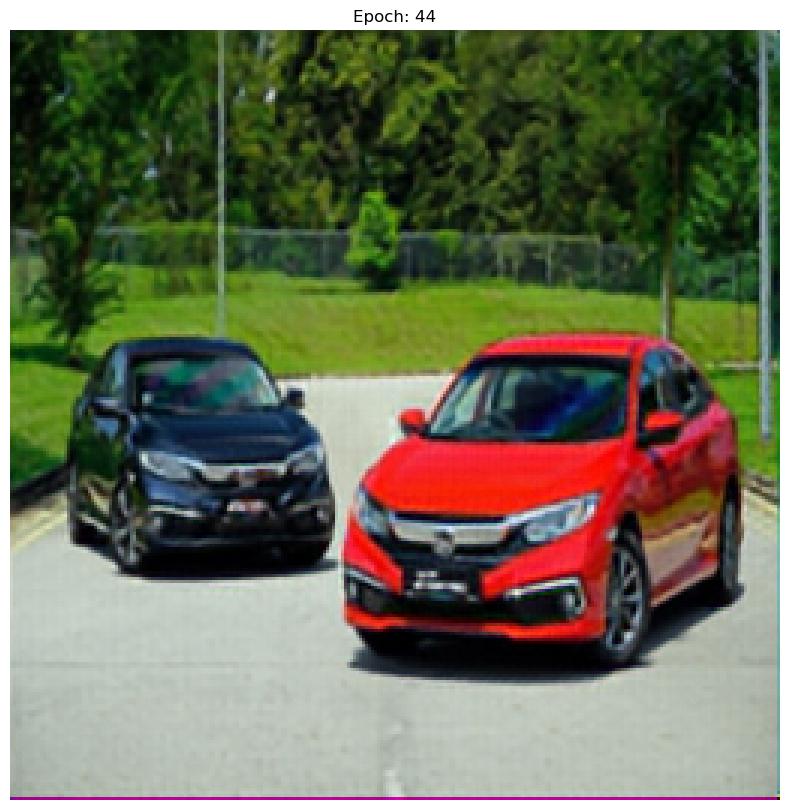

70/70 [==============================] - 10s 138ms/step - loss: 0.0175 - acc: 0.8200 - val_loss: 0.0195 - val_acc: 0.8359
Epoch 46/50
1/1 [==============================] - 0s 16ms/steploss: 0.0165 - acc: 0.83


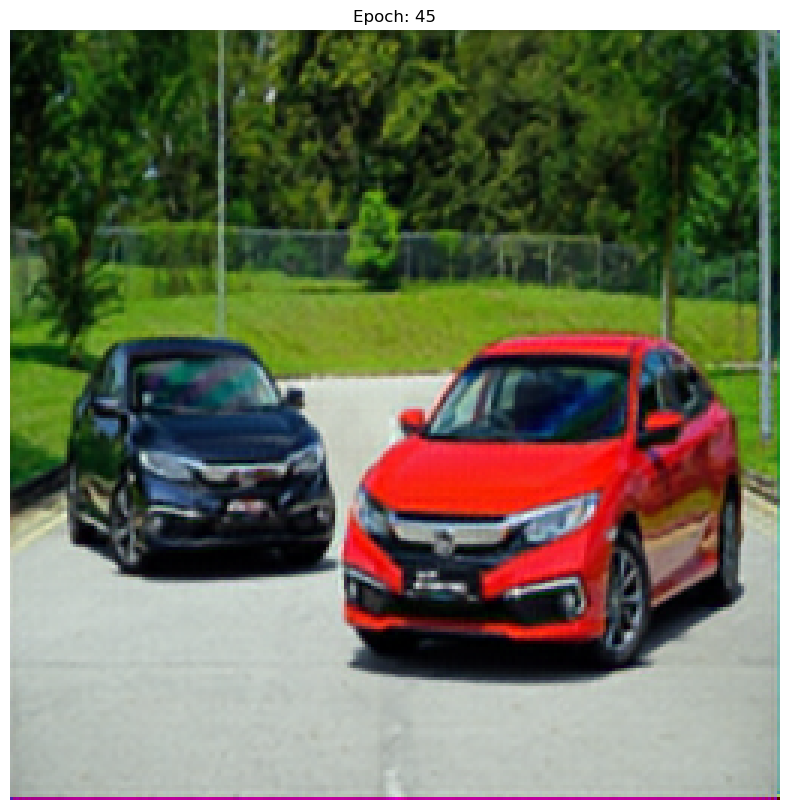

70/70 [==============================] - 9s 135ms/step - loss: 0.0165 - acc: 0.8320 - val_loss: 0.0194 - val_acc: 0.8351
Epoch 47/50
1/1 [==============================] - 0s 14ms/steploss: 0.0172 - acc: 0.82


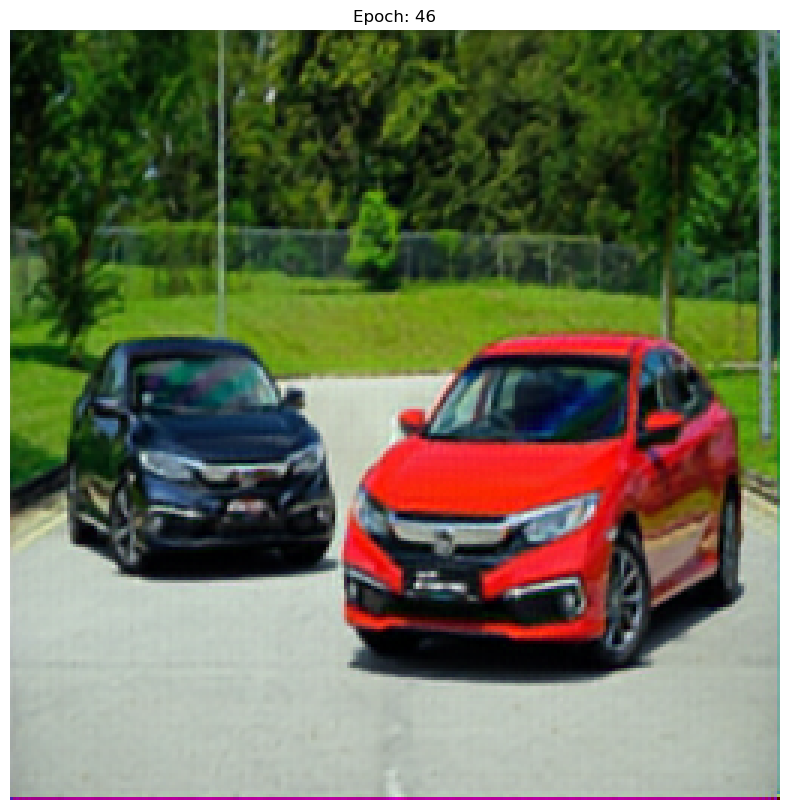

70/70 [==============================] - 10s 138ms/step - loss: 0.0172 - acc: 0.8276 - val_loss: 0.0200 - val_acc: 0.8078
Epoch 48/50
1/1 [==============================] - 0s 17ms/steploss: 0.0165 - acc: 0.83


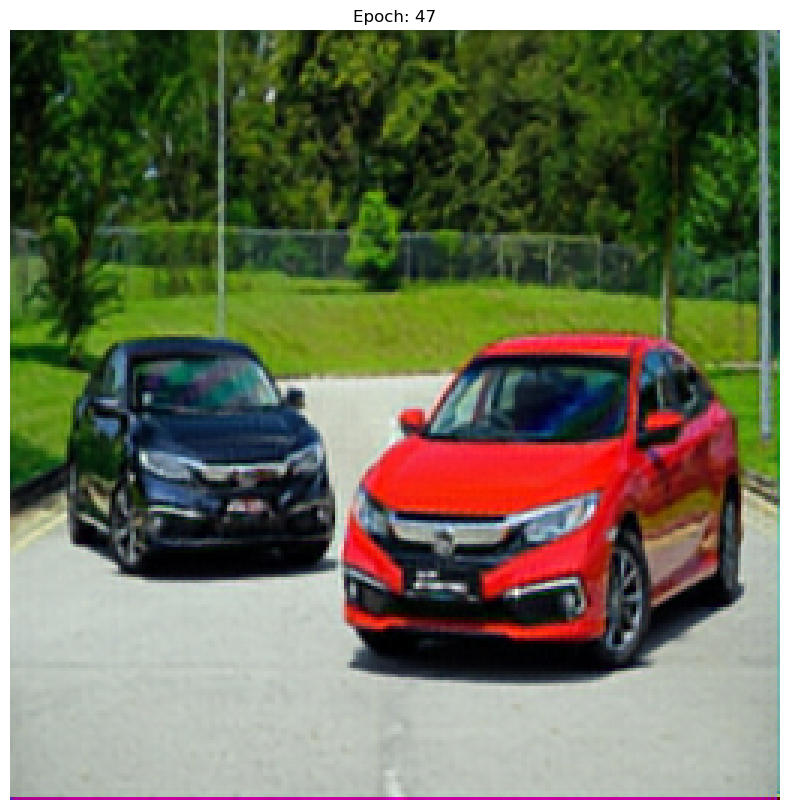

70/70 [==============================] - 10s 137ms/step - loss: 0.0165 - acc: 0.8337 - val_loss: 0.0196 - val_acc: 0.8394
Epoch 49/50
1/1 [==============================] - 0s 20ms/steploss: 0.0166 - acc: 0.82


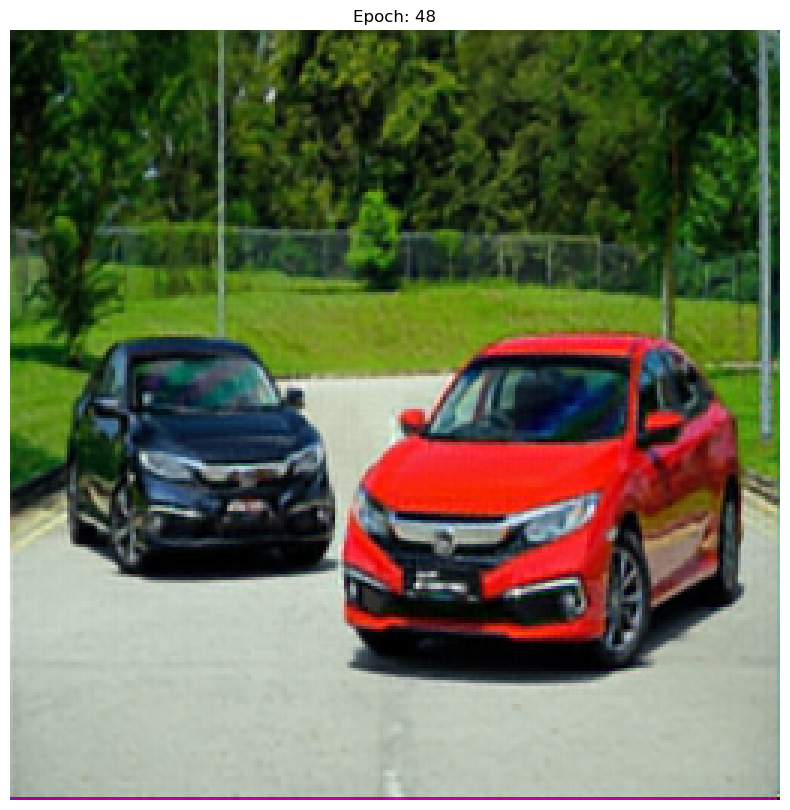

70/70 [==============================] - 10s 138ms/step - loss: 0.0166 - acc: 0.8277 - val_loss: 0.0204 - val_acc: 0.7999
Epoch 50/50
1/1 [==============================] - 0s 22ms/steploss: 0.0171 - acc: 0.83


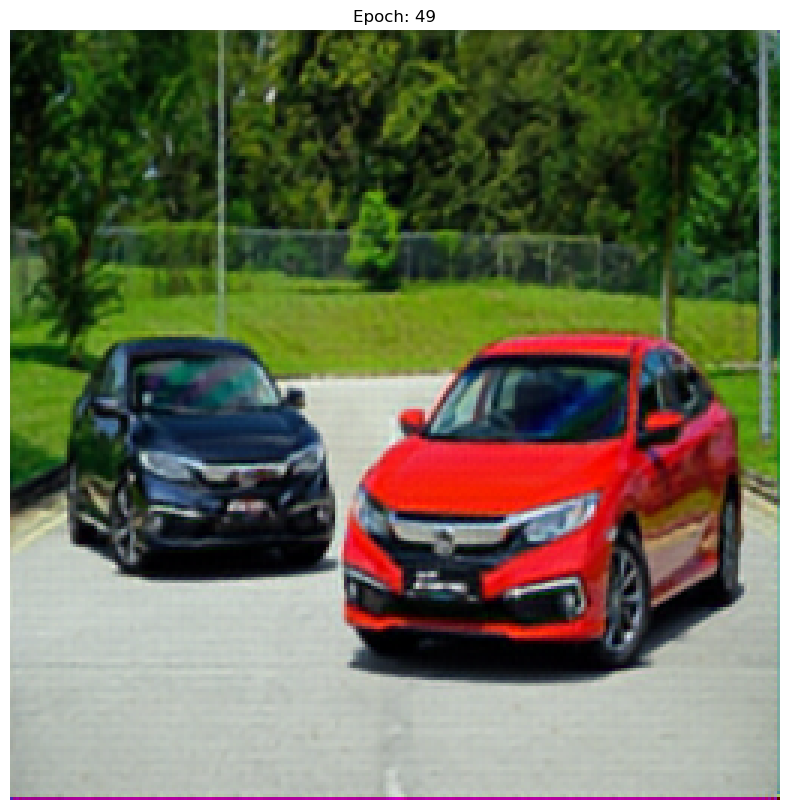

70/70 [==============================] - 10s 136ms/step - loss: 0.0171 - acc: 0.8324 - val_loss: 0.0197 - val_acc: 0.8643


In [16]:
history = model.fit(train_low_image, train_high_image, epochs = 50, batch_size = 10,
          validation_data = (validation_low_image,validation_high_image), callbacks=[image_callback])

In [30]:
# Получение истории обучения
training_loss = history.history['loss']
validation_loss = history.history['val_loss']
training_accuracy = history.history['acc']
validation_accuracy = history.history['val_acc']

In [31]:
epochs = range(1, len(training_loss) + 1)

C:\Users\IgorG\AppData\Local\Temp\ipykernel_6064\507022060.py:3: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  plt.plot(epochs, training_loss, 'b', label='Training loss', color='green')
C:\Users\IgorG\AppData\Local\Temp\ipykernel_6064\507022060.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  plt.plot(epochs, validation_loss, 'b', label='Validation loss', color='red')


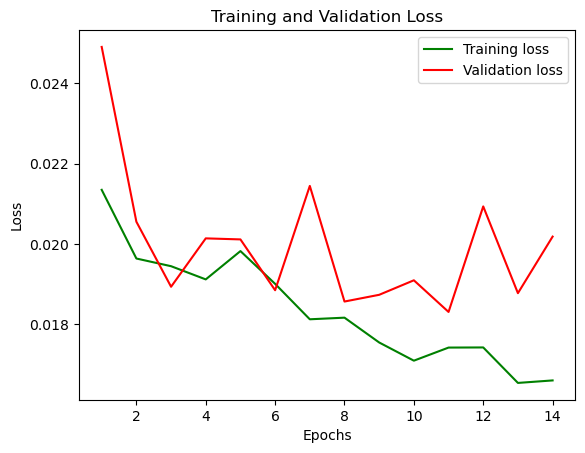

In [40]:
# График потерь
plt.figure()
plt.plot(epochs, training_loss, 'b', label='Training loss', color='green')
plt.plot(epochs, validation_loss, 'b', label='Validation loss', color='red')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

C:\Users\IgorG\AppData\Local\Temp\ipykernel_6064\2589980517.py:3: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  plt.plot(epochs, training_accuracy, 'b', label='Training accuracy', color='green')
C:\Users\IgorG\AppData\Local\Temp\ipykernel_6064\2589980517.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  plt.plot(epochs, validation_accuracy, 'b', label='Validation accuracy', color='red')


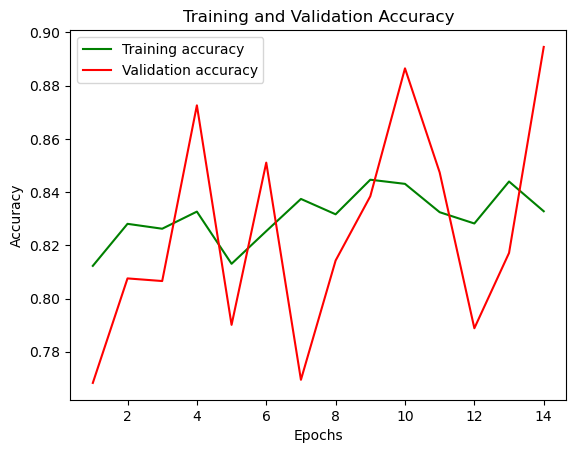

In [41]:
# График точности
plt.figure()
plt.plot(epochs, training_accuracy, 'b', label='Training accuracy', color='green')
plt.plot(epochs, validation_accuracy, 'b', label='Validation accuracy', color='red')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

1/1 [==============================] - 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


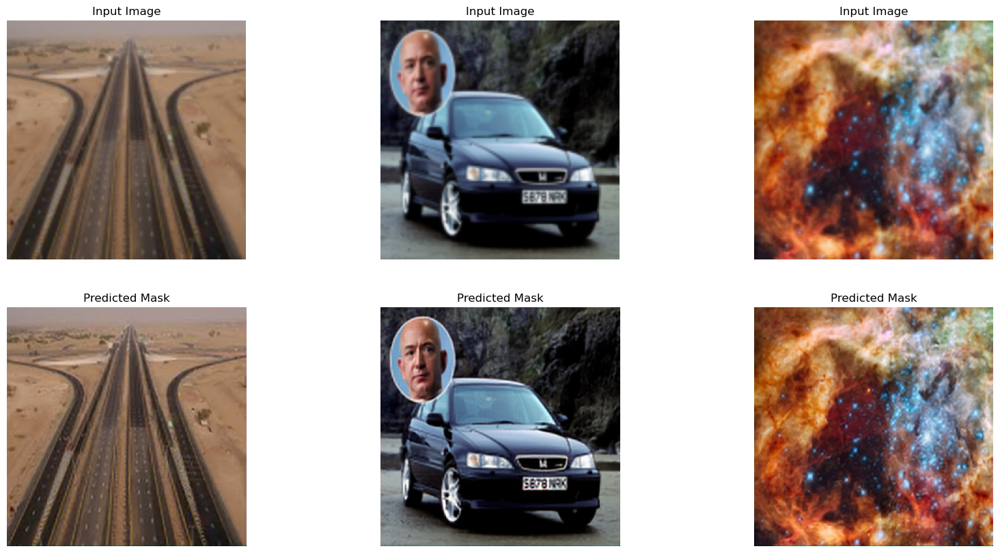

In [43]:
y_pred = model.predict(test_low_image)

# Визуализация результатов сегментации
n = 3  # Количество примеров для визуализации
plt.figure(figsize=(20, 10))
for i in range(n):
    plt.subplot(2, n, i + 1)
    plt.imshow(test_low_image[i])  # Отображение входного изображения
    plt.title('Input Image')
    plt.axis('off')

    plt.subplot(2, n, n + i + 1)
    plt.imshow(y_pred[i].squeeze(), cmap='gray')  # Отображение предсказанной маски
    plt.title('Predicted Mask')
    plt.axis('off')

plt.show()

In [45]:
model.save("final_model_3.h5")

In [9]:
model = load_model("final_model.h5")

1/1 [==============================] - 0s 22ms/step


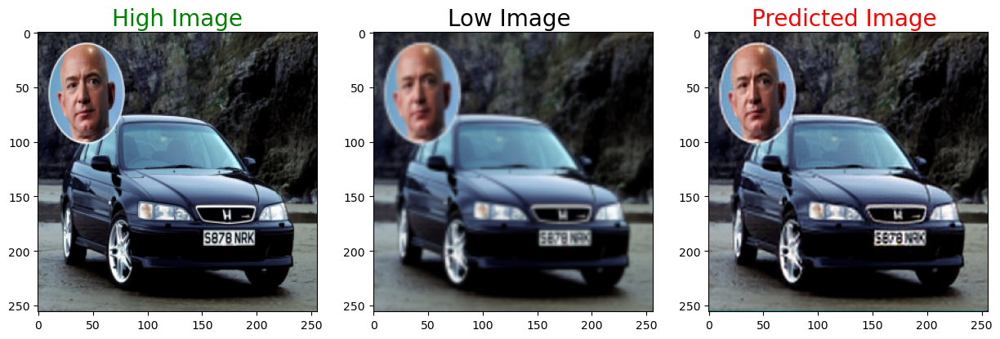

1/1 [==============================] - 0s 15ms/step


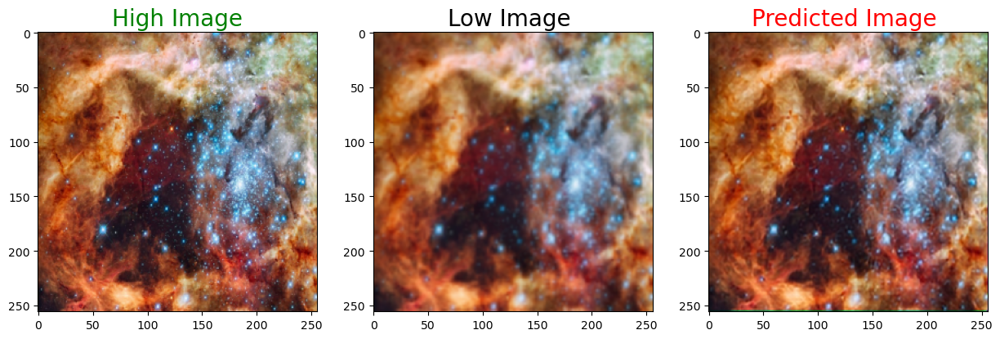

1/1 [==============================] - 0s 24ms/step


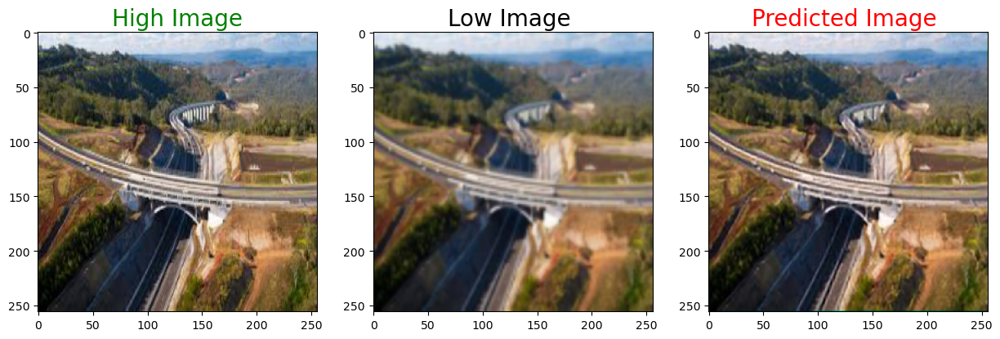

1/1 [==============================] - 0s 15ms/step


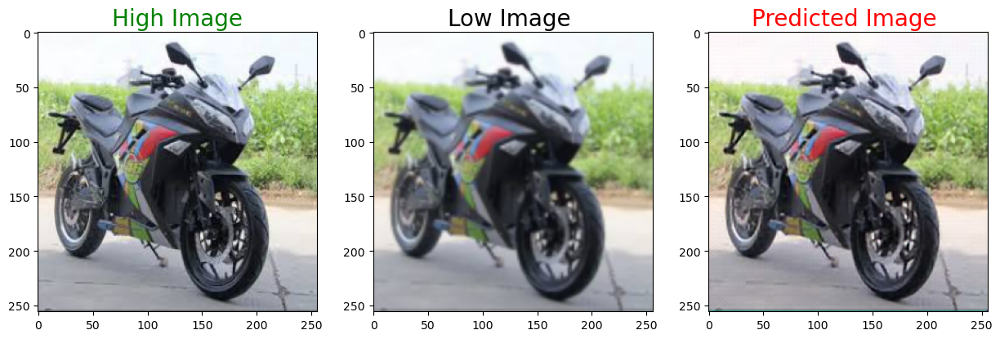

1/1 [==============================] - 0s 14ms/step


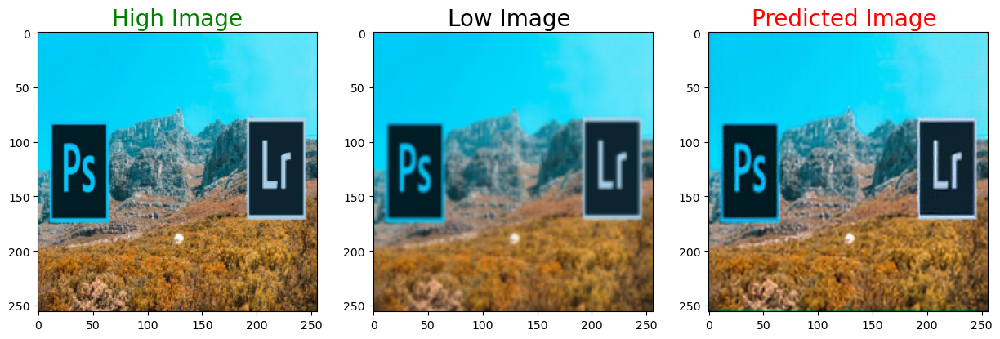

1/1 [==============================] - 0s 15ms/step


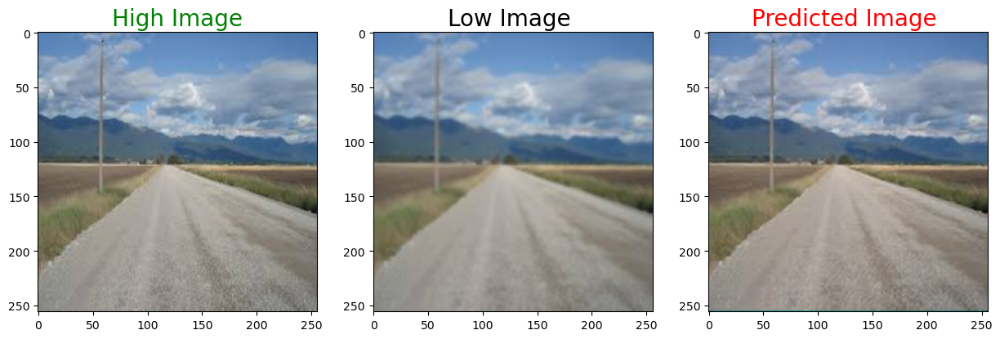

1/1 [==============================] - 0s 17ms/step


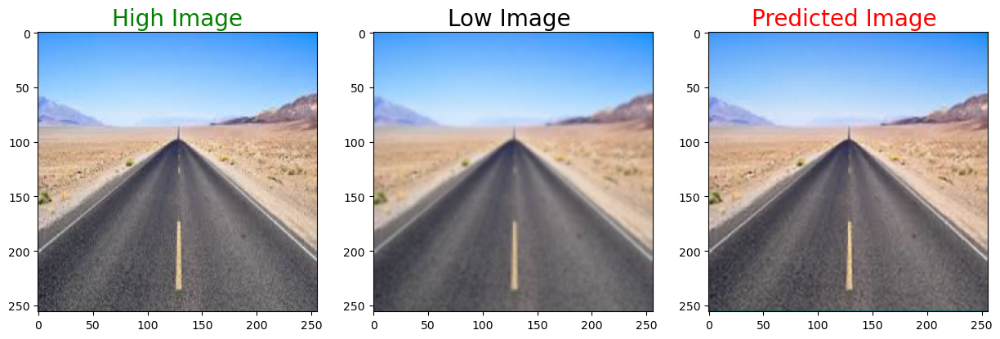

1/1 [==============================] - 0s 14ms/step


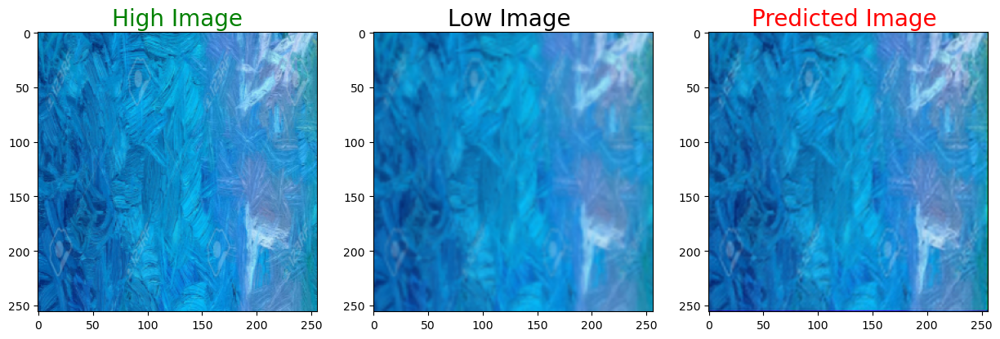

1/1 [==============================] - 0s 20ms/step


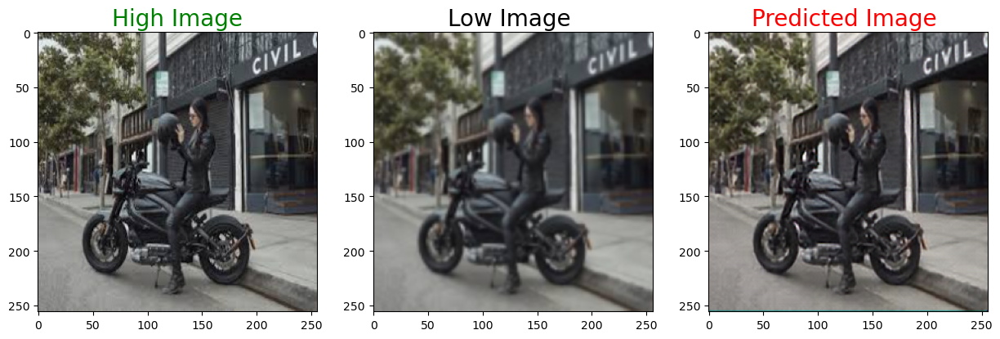

In [44]:
def plot_images(high,low,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('High Image', color = 'green', fontsize = 20)
    plt.imshow(high)
    plt.subplot(1,3,2)
    plt.title('Low Image ', color = 'black', fontsize = 20)
    plt.imshow(low)
    plt.subplot(1,3,3)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)
   
    plt.show()

for i in range(1,10):
    
    predicted = np.clip(model.predict(test_low_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    file_name = 'predicted_{}.jpg'.format(i)
    cv2.imwrite(file_name, cv2.cvtColor(predicted*255, cv2.COLOR_BGR2RGB))
    plot_images(test_high_image[i],test_low_image[i],predicted)

In [57]:
model = load_model(r'final_model.h5')

In [58]:
def single_predict(path, save=False):
    # Функция для печати изображения
    def plot_for_single(low,predicted):
        plt.figure(figsize=(10,10))
        plt.subplot(1,2,1)
        plt.title('Low Image ', color = 'black', fontsize = 20)
        plt.imshow(low)
        plt.subplot(1,2,2)
        plt.title('Predicted', color = 'green', fontsize = 20)
        plt.imshow(predicted)
        plt.show()

    # Считываем и подготавливаем изображение    
    SIZE = 256
    img = cv2.imread(path,1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0

    # Нормализуем цвета и используем predict
    predicted = np.clip(model.predict(img.reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    
    kernel = np.array([[0, -1, 0], 
                   [-1, 5, -1], 
                   [0, -1, 0]])
    predicted = cv2.filter2D(predicted, -1, kernel)
    predicted = cv2.resize(predicted, (2560, 2560))

    # Печатаем изображение
    plot_for_single(img, predicted)
    
    # Сохраняем, если нужно
    if save:
        file_name = 'predicted.jpg'
        cv2.imwrite(file_name, cv2.cvtColor(predicted*255, cv2.COLOR_BGR2RGB))

1/1 [==============================] - 0s 117ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


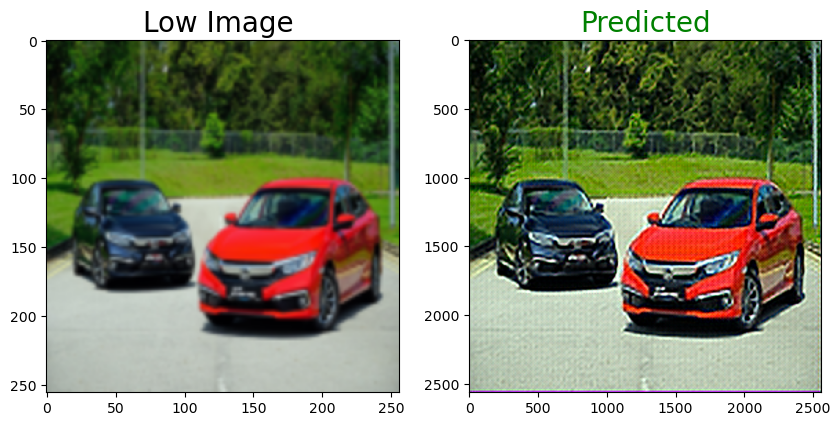

In [59]:
# первая версия
single_predict('0.png', 1)

1/1 [==============================] - 0s 14ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


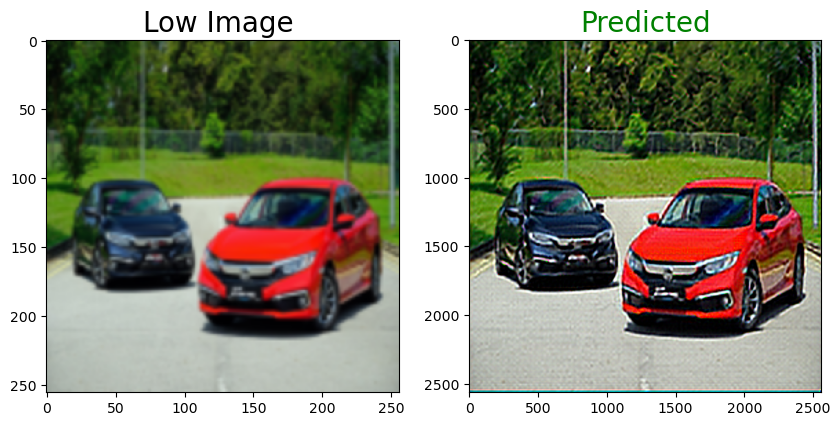

In [56]:
# вторая версия
single_predict('0.png', 1)

In [9]:
def predict_two_models(path):
    
    model_1 = load_model(r'final_model.h5')    
    model_2 = load_model(r'final_model_2.h5')
    
    # Функция для печати изображения
    def plot_for_two_models(low,predicted_1,predicted_2):
        plt.figure(figsize=(15,15))
        plt.subplot(1,2,1)
        plt.title('Первая модель (5 эпох)', color = 'green', fontsize = 15)
        plt.imshow(predicted_1)
        plt.subplot(1,2,2)
        plt.title('Вторая модель (14 эпох)', color = 'green', fontsize = 15)
        plt.imshow(predicted_2)
        plt.show()
        
#         plt.figure(figsize=(15,15))
#         plt.subplot(1,3,1)
#         plt.title('Начальное изображение', color = 'black', fontsize = 15)
#         plt.imshow(low)
#         plt.subplot(1,3,2)
#         plt.title('Первая модель (5 эпох)', color = 'green', fontsize = 15)
#         plt.imshow(predicted_1)
#         plt.subplot(1,3,3)
#         plt.title('Вторая модель (14 эпох)', color = 'green', fontsize = 15)
#         plt.imshow(predicted_2)
#         plt.show()
        
#         plt.figure(figsize=(10, 10))
#         plt.subplot(3, 1, 1)
#         plt.title('Начальное изображение', color='black', fontsize=10)
#         plt.imshow(low)
#         plt.subplot(3, 1, 2)
#         plt.title('Первая модель (5 эпох)', color='green', fontsize=10)
#         plt.imshow(predicted_1)
#         plt.subplot(3, 1, 3)
#         plt.title('Вторая модель (14 эпох)', color='green', fontsize=10)
#         plt.imshow(predicted_2)
#         plt.tight_layout()  # Для автоматической компоновки графиков
#         plt.show()

    # Считываем и подготавливаем изображение    
    SIZE = 256
    img = cv2.imread(path,1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0

    # Нормализуем цвета и используем predict
    predicted_1 = np.clip(model_1.predict(img.reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    predicted_2 = np.clip(model_2.predict(img.reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    
    kernel = np.array([[0, -1, 0], 
                   [-1, 5, -1], 
                   [0, -1, 0]])
    predicted_1 = cv2.filter2D(predicted_1, -1, kernel)
    predicted_1 = cv2.resize(predicted_1, (2560, 2560))
    
    predicted_2 = cv2.filter2D(predicted_2, -1, kernel)
    predicted_2 = cv2.resize(predicted_2, (2560, 2560))

    # Печатаем изображение
    plot_for_two_models(img, predicted_1, predicted_2)

1/1 [==============================] - 0s 125ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


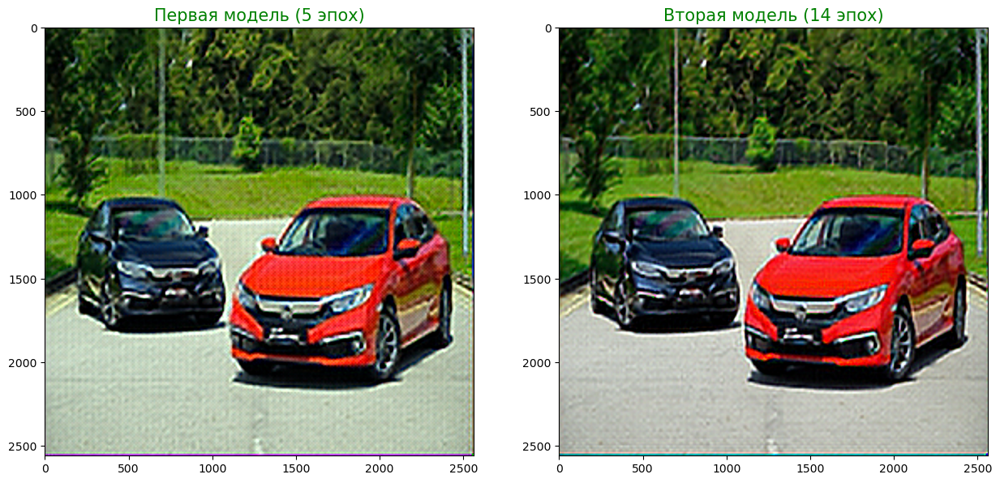

In [19]:
# Обе версии
predict_two_models('0.png')

1/1 [==============================] - 0s 116ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


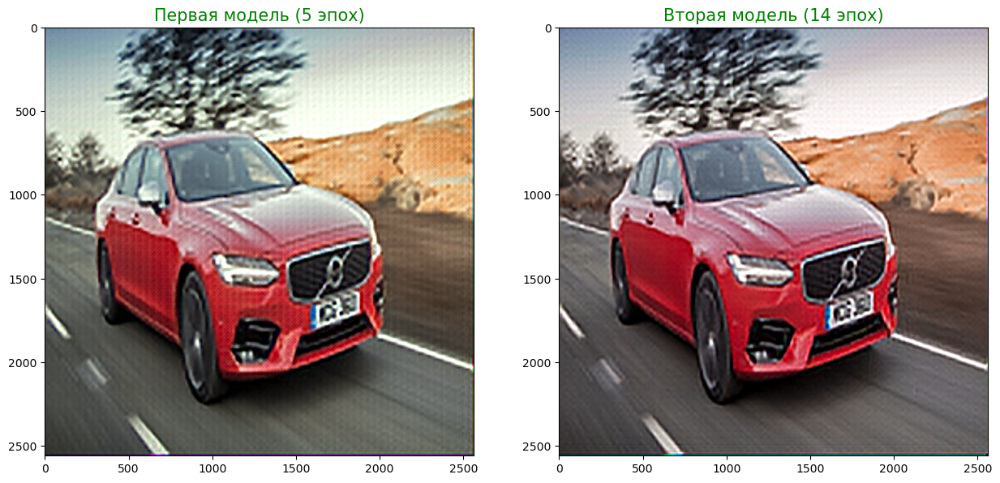

In [12]:
predict_two_models('18.png')